In [ ]:
# Cell 1: Introduction and Project Setup

import tensorflow as tf
from tensorflow.keras import layers
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from tqdm import tqdm
import time

print("TensorFlow Version:", tf.__version__)

IMG_WIDTH = 64
IMG_HEIGHT = 64
IMG_CHANNELS = 3

# Training Hyperparameters
BUFFER_SIZE = 20000 
BATCH_SIZE = 128    
EPOCHS = 100       
NOISE_DIM = 100    
CLOTH_DIR = "/kaggle/input/clothestry/clothes_tryon_dataset/train/cloth"
STYLE_CSV_PATH = "/kaggle/input/cloth-style/cloth_style_profile.csv"
OUTPUT_DIR = "/kaggle/working/gan_outputs/"

if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)

TensorFlow Version: 2.18.0


In [ ]:

style_df = pd.read_csv(STYLE_CSV_PATH)

style_df['label'], style_labels_map = pd.factorize(style_df['style_category'])
num_classes = len(style_labels_map)
print(f"Found {num_classes} unique style categories.")
label_to_style = {i: style for i, style in enumerate(style_labels_map)}
style_to_label = {style: i for i, style in enumerate(style_labels_map)}
print("\nFirst 5 Style Mappings:")
for i in range(5):
    print(f"  Label {i}: {label_to_style[i]}")

filename_to_label = pd.Series(style_df.label.values, index=style_df.filename).to_dict()

image_paths = []
image_labels = []
for filename in os.listdir(CLOTH_DIR):
    if filename in filename_to_label:
        image_paths.append(os.path.join(CLOTH_DIR, filename))
        image_labels.append(filename_to_label[filename])

print(f"\nPrepared {len(image_paths)} images and labels for training.")

def load_and_preprocess_image(path, label):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=IMG_CHANNELS)
    image = tf.image.resize(image, [IMG_HEIGHT, IMG_WIDTH])
    image = (tf.cast(image, tf.float32) - 127.5) / 127.5
    return image, label

dataset = tf.data.Dataset.from_tensor_slices((image_paths, image_labels))
dataset = dataset.map(load_and_preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE, drop_remainder=True)
print("\n tf.data.Dataset created successfully.")

Found 8 unique style categories.

First 5 Style Mappings:
  Label 0: a casual t-shirt or everyday top
  Label 1: a sporty activewear top or athletic jersey
  Label 2: bohemian or festival style clothing
  Label 3: a formal business blouse or professional shirt
  Label 4: an elegant evening gown or glamorous party dress

Prepared 11647 images and labels for training.

 tf.data.Dataset created successfully.


In [ ]:

def build_generator():
    noise_input = layers.Input(shape=(NOISE_DIM,))
    label_input = layers.Input(shape=(1,))
    
    label_embedding = layers.Embedding(num_classes, 50)(label_input)
    label_embedding = layers.Dense(4 * 4)(label_embedding)
    label_embedding = layers.Reshape((4, 4, 1))(label_embedding)

    noise_dense = layers.Dense(4*4*256, use_bias=False)(noise_input)
    noise_dense = layers.BatchNormalization()(noise_dense)
    noise_dense = layers.LeakyReLU()(noise_dense)
    noise_reshaped = layers.Reshape((4, 4, 256))(noise_dense)
    
    merged = layers.Concatenate()([noise_reshaped, label_embedding])

    
    model = layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False)(merged)
    model = layers.BatchNormalization()(model)
    model = layers.LeakyReLU()(model)
    
    # Block 2: 8x8 -> 16x16
    model = layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False)(model)
    model = layers.BatchNormalization()(model)
    model = layers.LeakyReLU()(model)

    # Block 3: 16x16 -> 32x32
    model = layers.Conv2DTranspose(32, (5, 5), strides=(2, 2), padding='same', use_bias=False)(model)
    model = layers.BatchNormalization()(model)
    model = layers.LeakyReLU()(model)

    # Block 4: 32x32 -> 64x64 (Output Layer)
    output_image = layers.Conv2DTranspose(IMG_CHANNELS, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh')(model)

    return tf.keras.Model([noise_input, label_input], output_image)

# It takes a 64x64 image and a style label, and outputs a single value (real or fake).
def build_discriminator():
    # Input for the image
    image_input = layers.Input(shape=[IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS])
    # Input for the conditional label
    label_input = layers.Input(shape=(1,))

    # Embed the label and reshape it to match the image dimensions for concatenation
    label_embedding = layers.Embedding(num_classes, 50)(label_input)
    label_embedding = layers.Dense(IMG_HEIGHT * IMG_WIDTH)(label_embedding)
    label_embedding = layers.Reshape((IMG_HEIGHT, IMG_WIDTH, 1))(label_embedding)

    # Concatenate the image and the processed label
    merged = layers.Concatenate()([image_input, label_embedding])

    # Downsampling blocks
    # Block 1: 64x64 -> 32x32
    model = layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same')(merged)
    model = layers.LeakyReLU()(model)
    model = layers.Dropout(0.3)(model)

    # Block 2: 32x32 -> 16x16
    model = layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same')(model)
    model = layers.LeakyReLU()(model)
    model = layers.Dropout(0.3)(model)
    
    # Block 3: 16x16 -> 8x8
    model = layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same')(model)
    model = layers.LeakyReLU()(model)
    model = layers.Dropout(0.3)(model)
    
    # Flatten and output a single logit
    model = layers.Flatten()(model)
    output_logit = layers.Dense(1)(model)

    return tf.keras.Model([image_input, label_input], output_logit)

# Instantiate the models
generator = build_generator()
discriminator = build_discriminator()

print("✅ Generator and Discriminator models built.")
generator.summary()

✅ Generator and Discriminator models built.


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 100)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_5 (Dense)     │ (None, 4096)      │    409,600 │ input_layer_4[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_5       │ (None, 1)         │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 4096)      │     16,384 │ dense_5[0][0]     │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_2         │ (None, 1, 50)     │        400 │ input_layer_5[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_7       │ (None, 4096)      │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_4 (Dense)     │ (None, 1, 16)     │        816 │ embedding_2[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_4 (Reshape) │ (None, 4, 4, 256) │          0 │ leaky_re_lu_7[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_3 (Reshape) │ (None, 4, 4, 1)   │          0 │ dense_4[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_2       │ (None, 4, 4, 257) │          0 │ reshape_4[0][0],  │
│ (Concatenate)       │                   │            │ reshape_3[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_4  │ (None, 8, 8, 128) │    822,400 │ concatenate_2[0]… │
│ (Conv2DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 8, 8, 128) │        512 │ conv2d_transpose… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_8       │ (None, 8, 8, 128) │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_5  │ (None, 16, 16,    │    204,800 │ leaky_re_lu_8[0]… │
│ (Conv2DTranspose)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │        256 │ conv2d_transpose… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_9       │ (None, 16, 16,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_6  │ (None, 32, 32,    │     51,200 │ leaky_re_lu_9[0]… │
│ (Conv2DTranspose)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        128 │ conv2d_transpose… │
│ (BatchNormalizatio… │ 32)               │            │                 

 Total params: 1,508,896 (5.76 MB)

 Trainable params: 1,500,256 (5.72 MB)

 Non-trainable params: 8,640 (33.75 KB)

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

# The generator's loss measures how well it was able to trick the discriminator.
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# Use the Adam optimizer for both models
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

# --- The Single Training Step ---
# Use tf.function for a massive performance boost by compiling the function.
@tf.function
def train_step(images, labels):
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator([noise, labels], training=True)

        real_output = discriminator([images, labels], training=True)
        fake_output = discriminator([generated_images, labels], training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

print(" Loss functions, optimizers, and train_step defined.")

 Loss functions, optimizers, and train_step defined.


 Starting Training...
Epoch 1 completed.


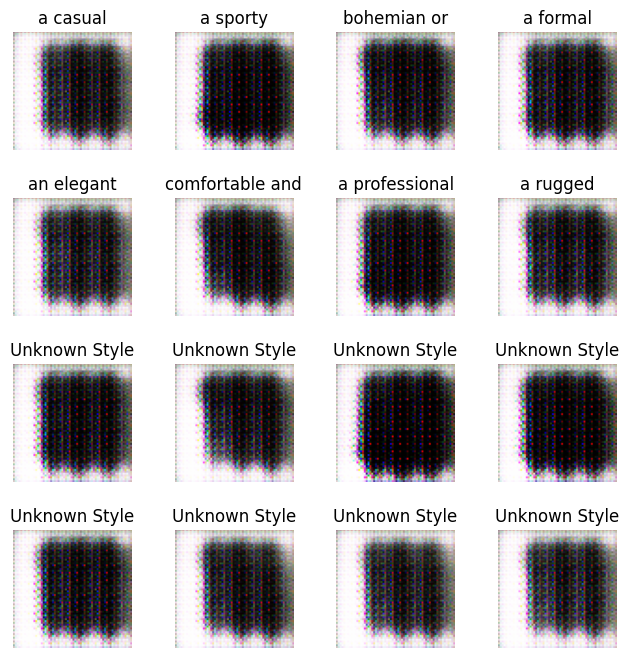

Time for epoch 1 is 30.23 sec
Epoch 2 completed.


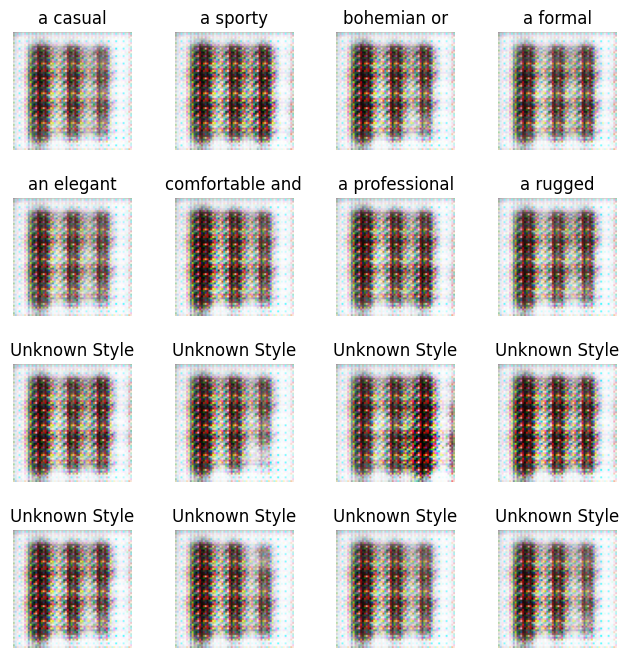

Time for epoch 2 is 29.38 sec
Epoch 3 completed.


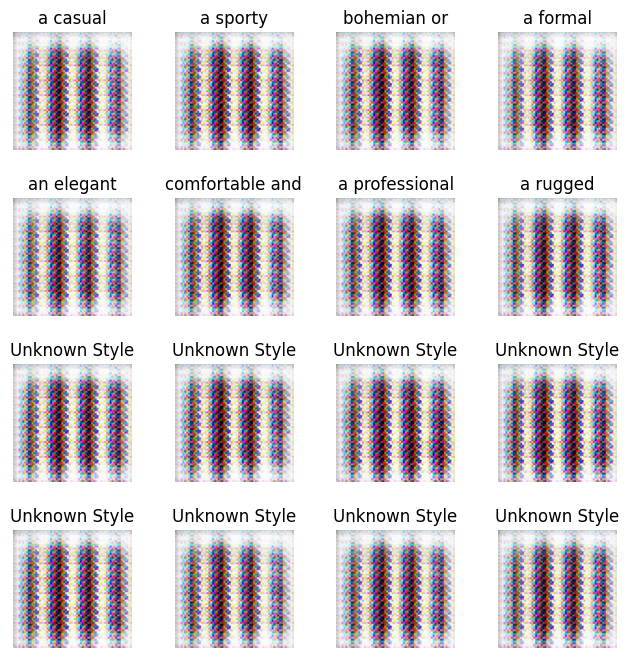

Time for epoch 3 is 28.61 sec
Epoch 4 completed.


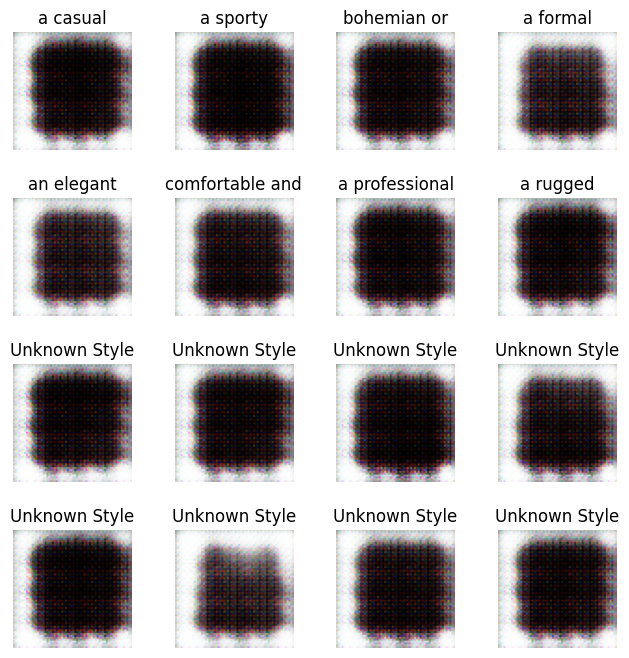

Time for epoch 4 is 29.70 sec
Epoch 5 completed.


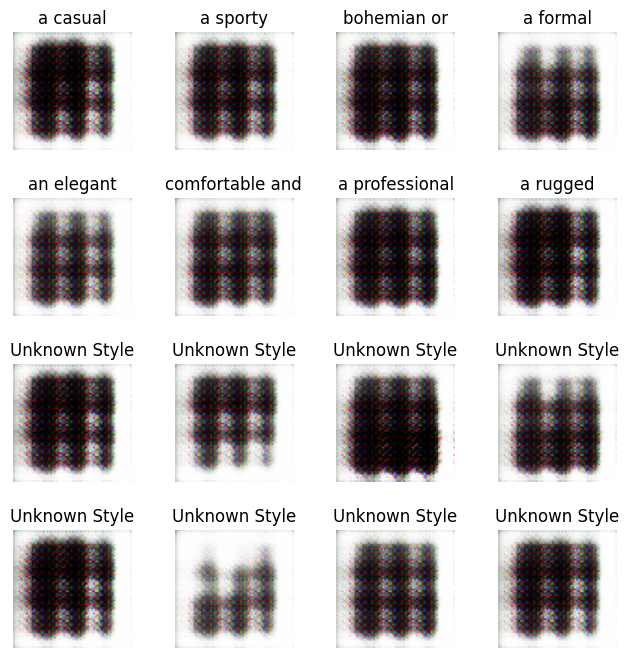

Time for epoch 5 is 28.92 sec
Epoch 6 completed.


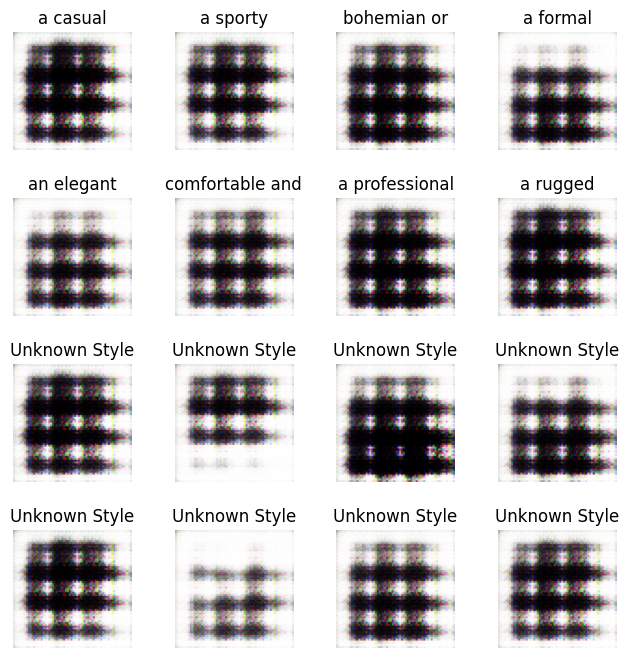

Time for epoch 6 is 28.37 sec
Epoch 7 completed.


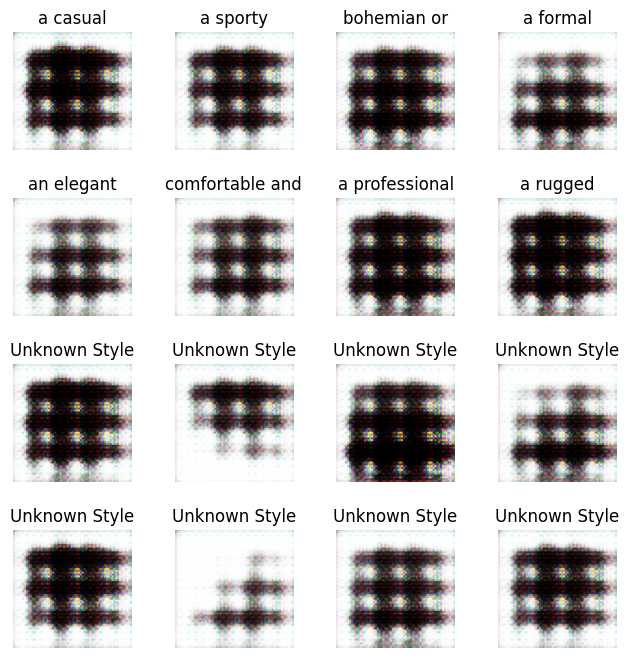

Time for epoch 7 is 29.66 sec
Epoch 8 completed.


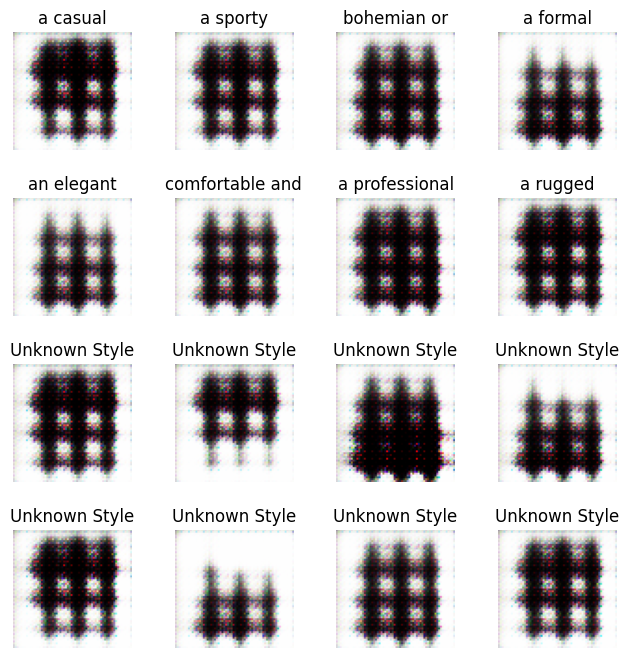

Time for epoch 8 is 29.52 sec
Epoch 9 completed.


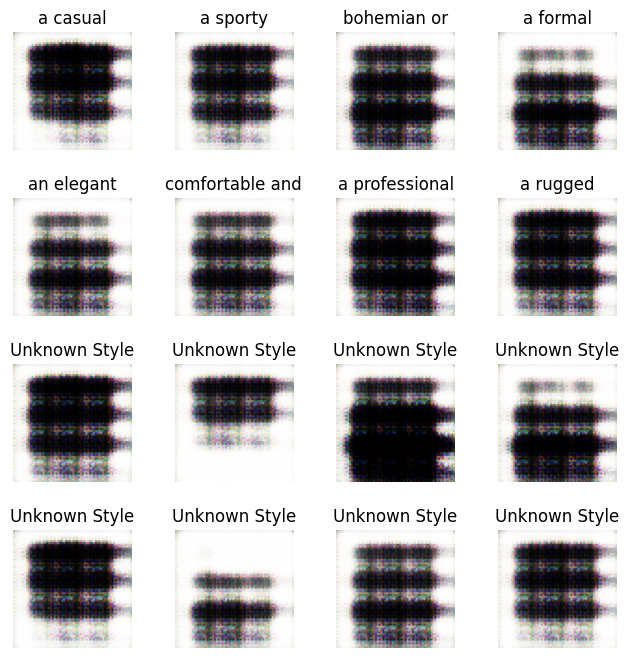

Time for epoch 9 is 29.34 sec
Epoch 10 completed.


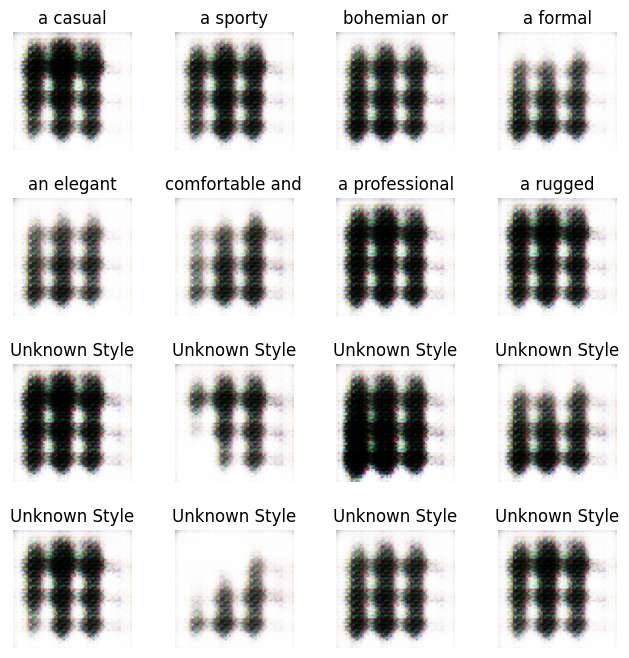

Time for epoch 10 is 29.81 sec
Epoch 11 completed.


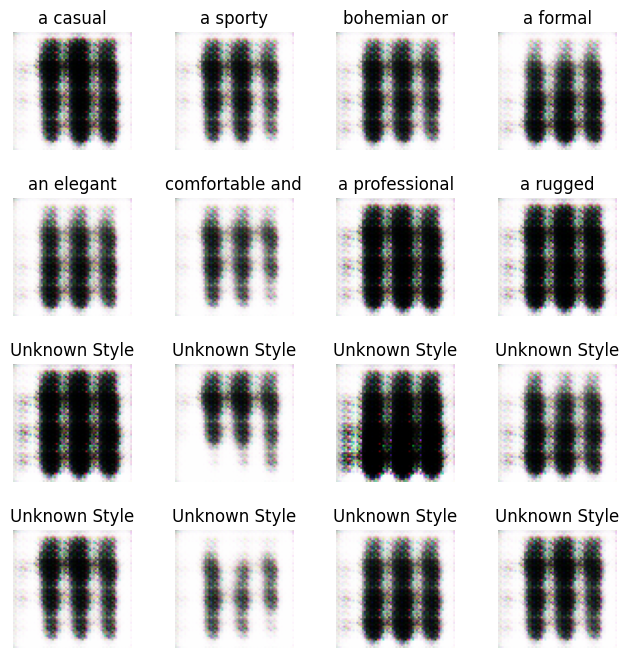

Time for epoch 11 is 29.53 sec
Epoch 12 completed.


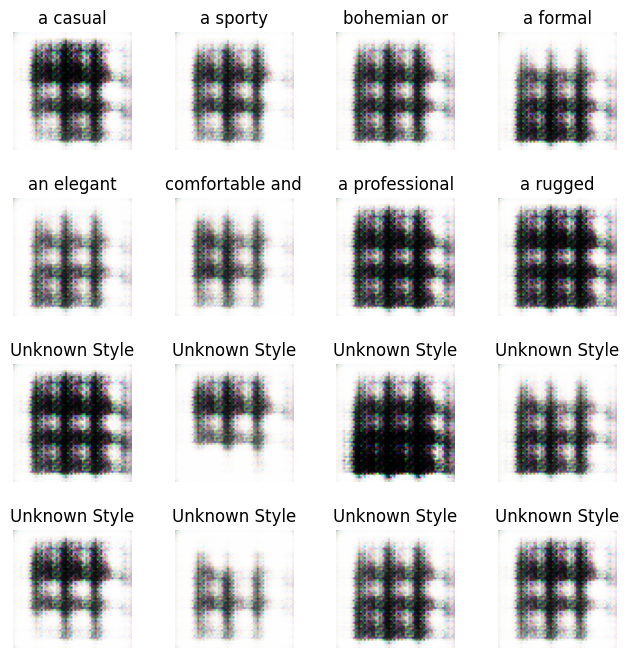

Time for epoch 12 is 29.13 sec
Epoch 13 completed.


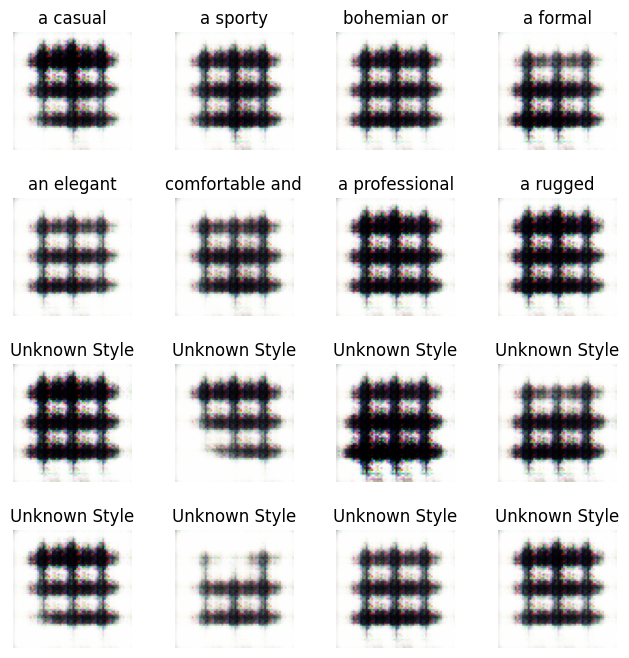

Time for epoch 13 is 29.95 sec
Epoch 14 completed.


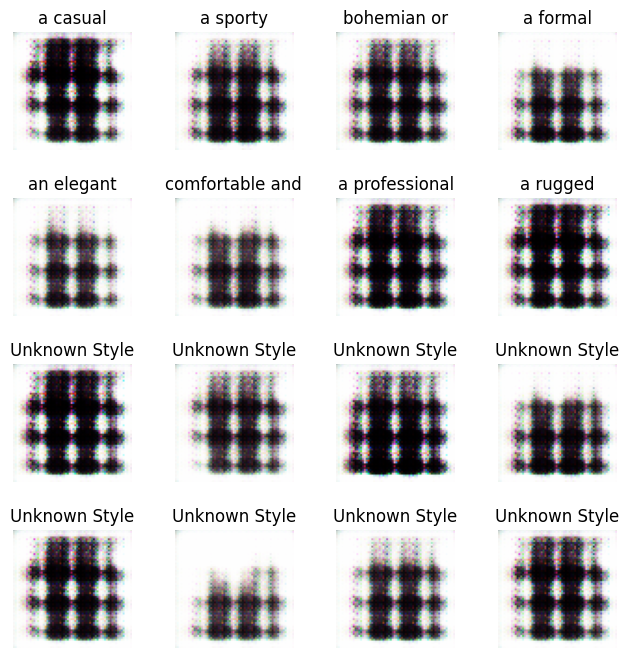

Time for epoch 14 is 28.80 sec
Epoch 15 completed.


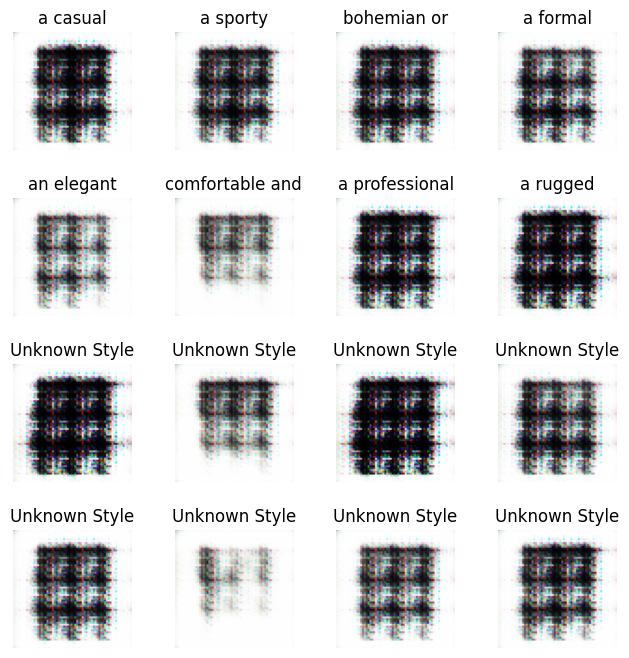

Time for epoch 15 is 28.99 sec
Epoch 16 completed.


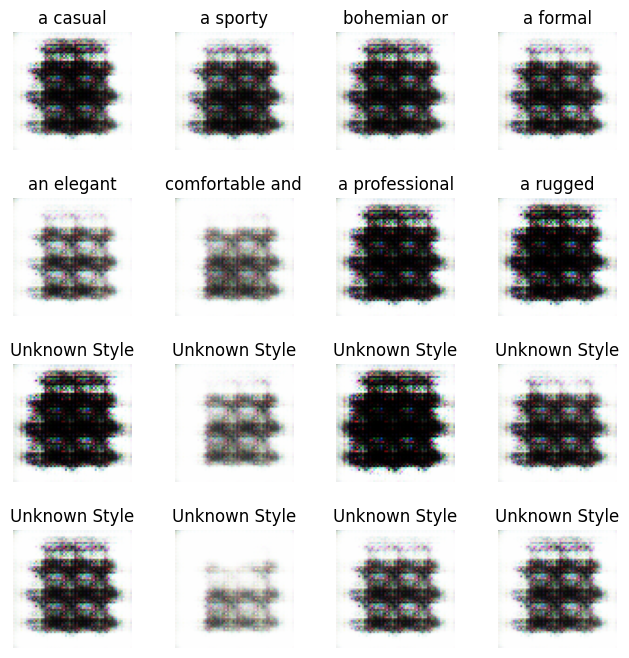

Time for epoch 16 is 29.04 sec
Epoch 17 completed.


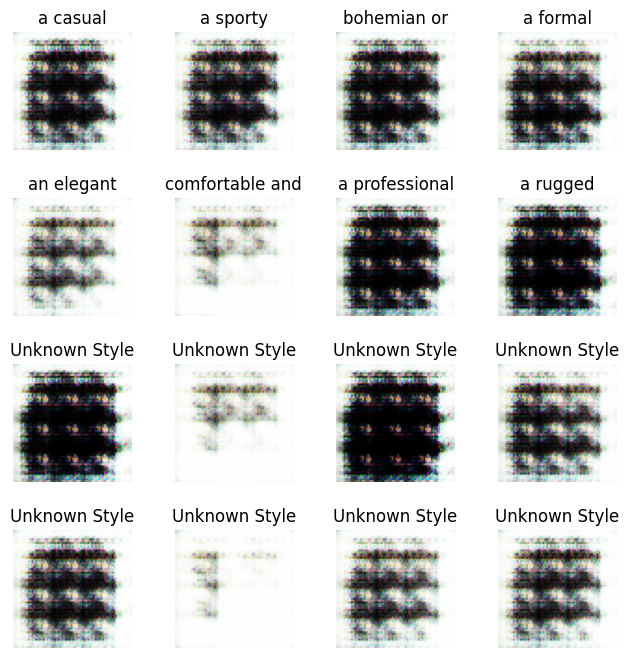

Time for epoch 17 is 29.07 sec
Epoch 18 completed.


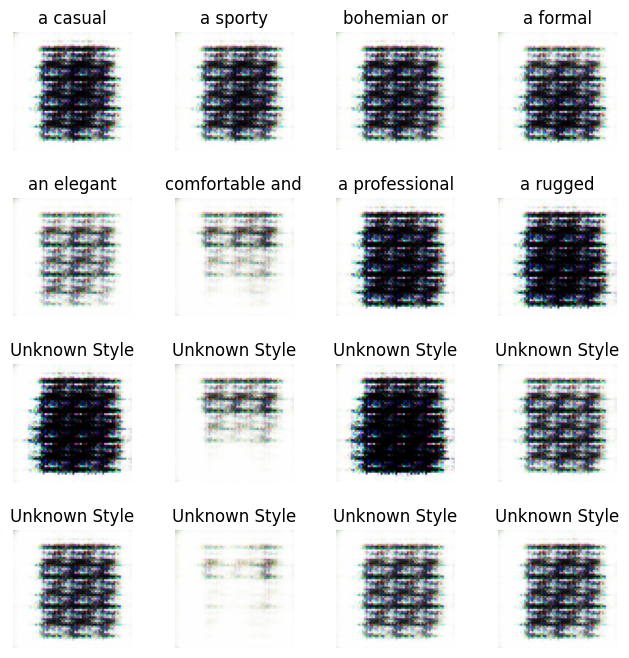

Time for epoch 18 is 28.61 sec
Epoch 19 completed.


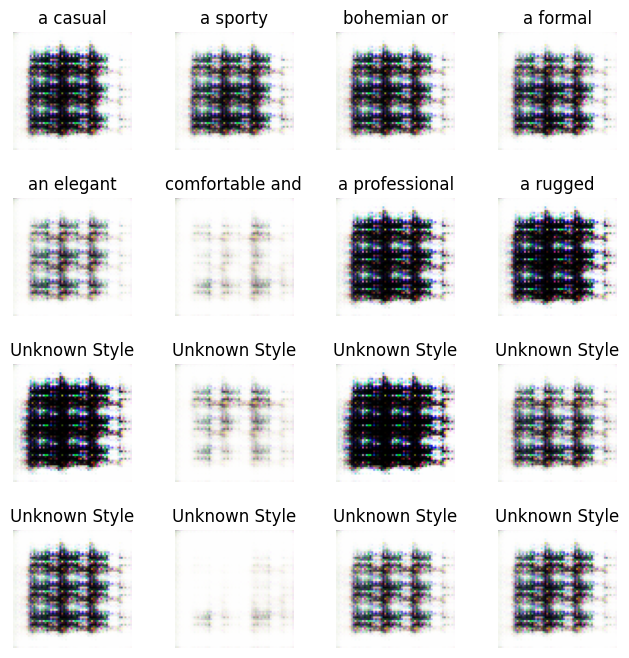

Time for epoch 19 is 30.23 sec
Epoch 20 completed.


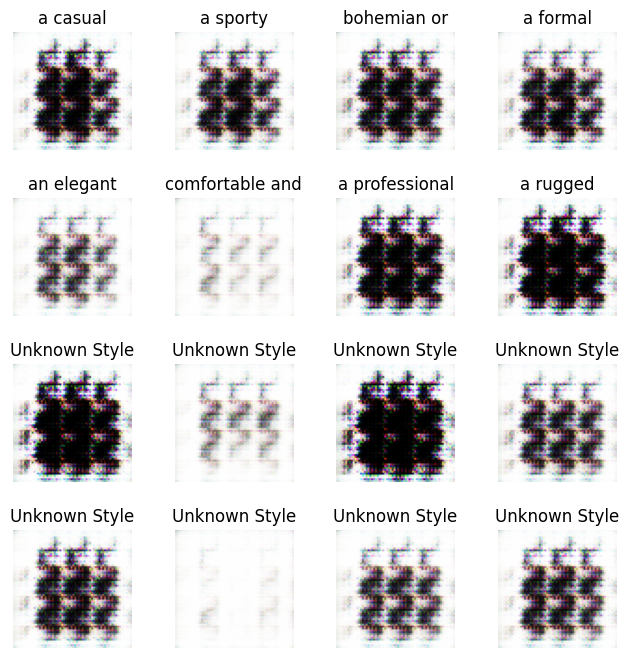

Time for epoch 20 is 29.25 sec
Epoch 21 completed.
Epoch 25 completed.


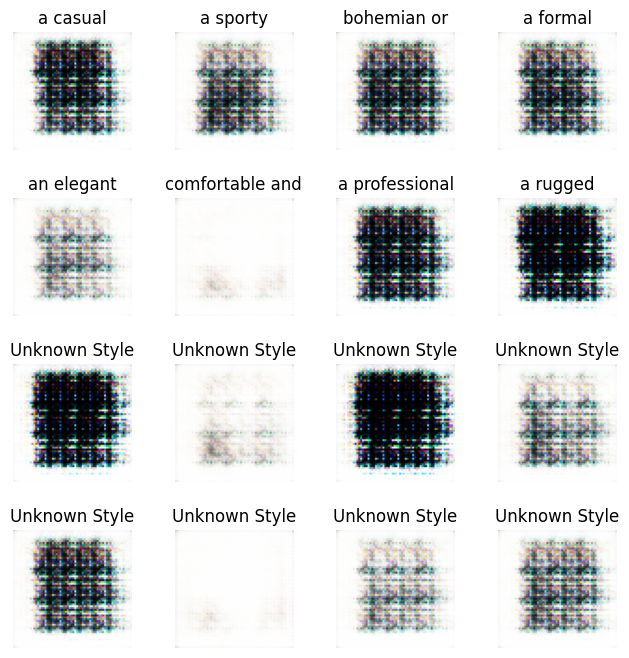

Time for epoch 25 is 29.81 sec
Epoch 26 completed.


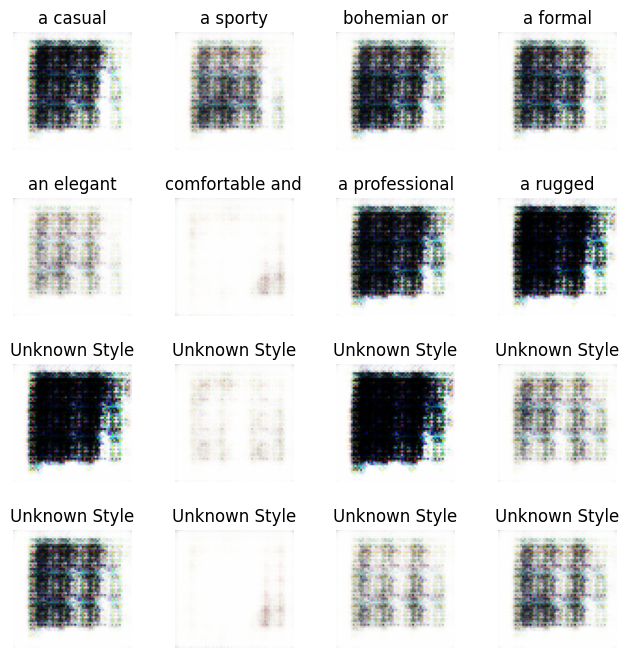

Time for epoch 26 is 28.74 sec
Epoch 27 completed.


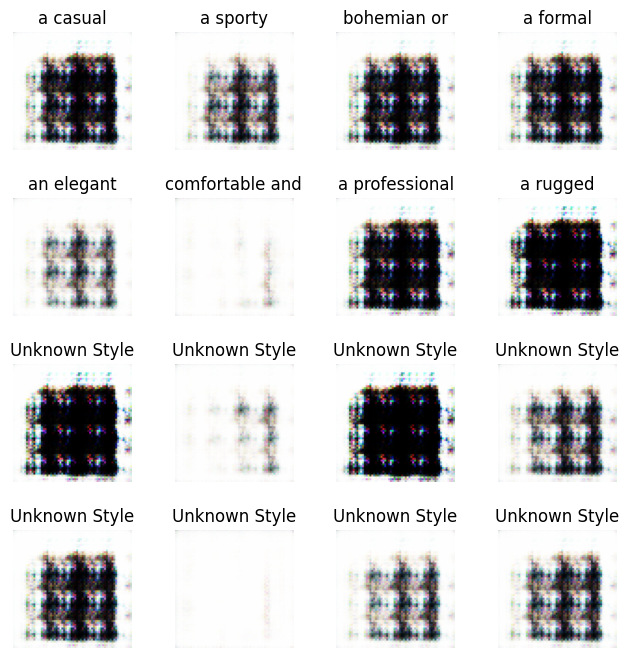

Time for epoch 27 is 28.88 sec
Epoch 28 completed.


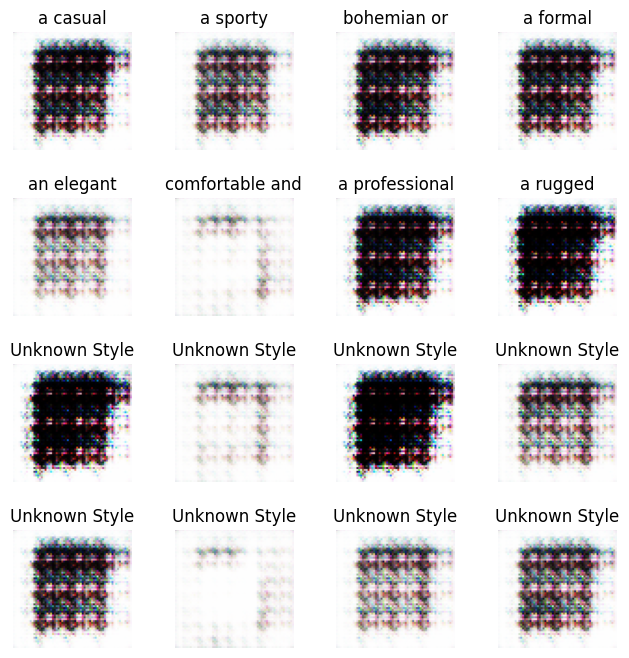

Time for epoch 28 is 28.74 sec
Epoch 29 completed.


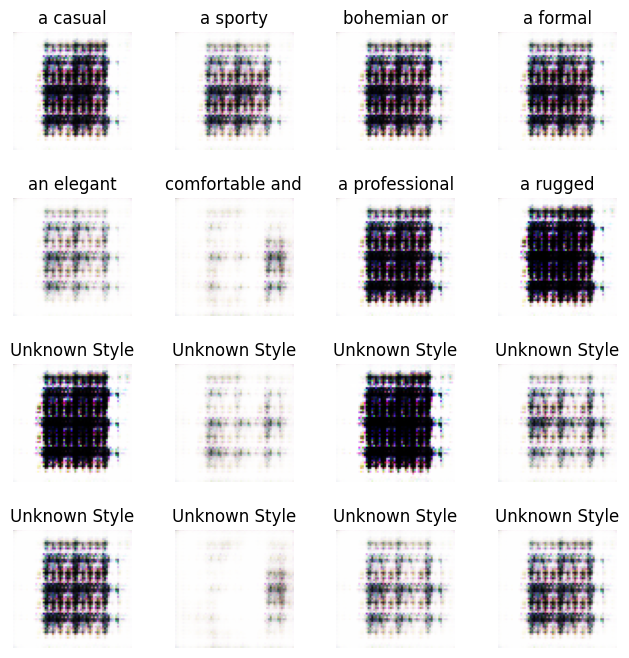

Time for epoch 29 is 28.91 sec
Epoch 30 completed.


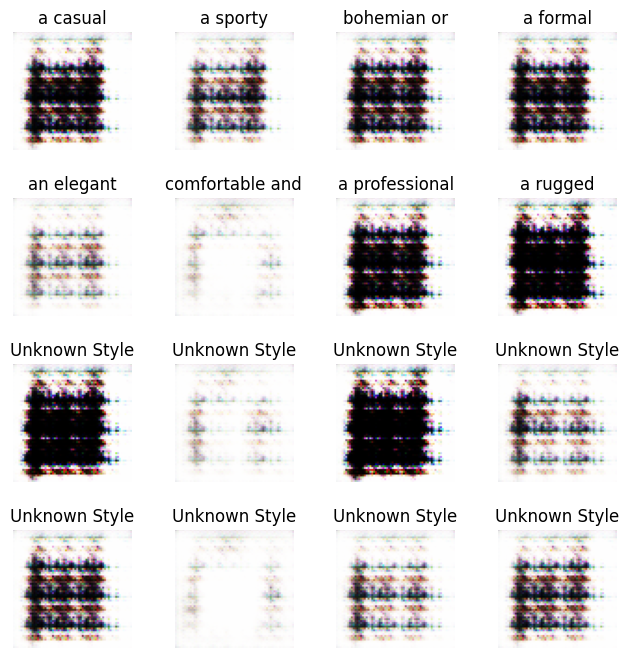

Time for epoch 30 is 28.89 sec
Epoch 31 completed.


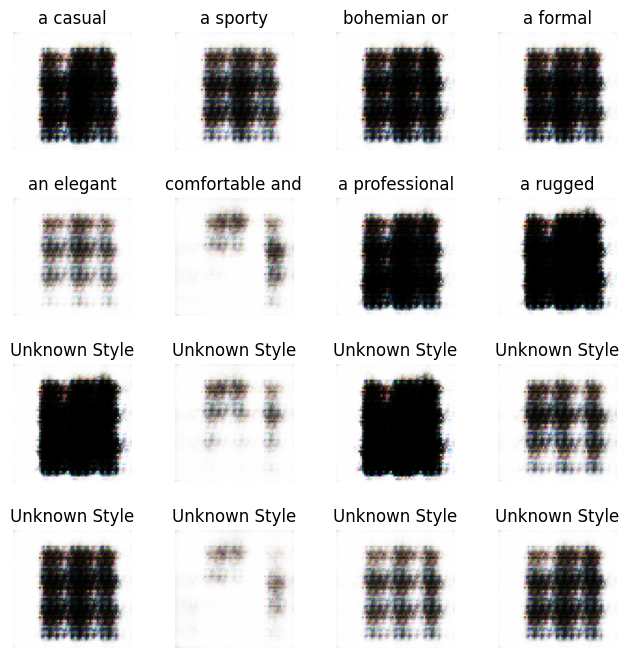

Time for epoch 31 is 29.60 sec
Epoch 32 completed.


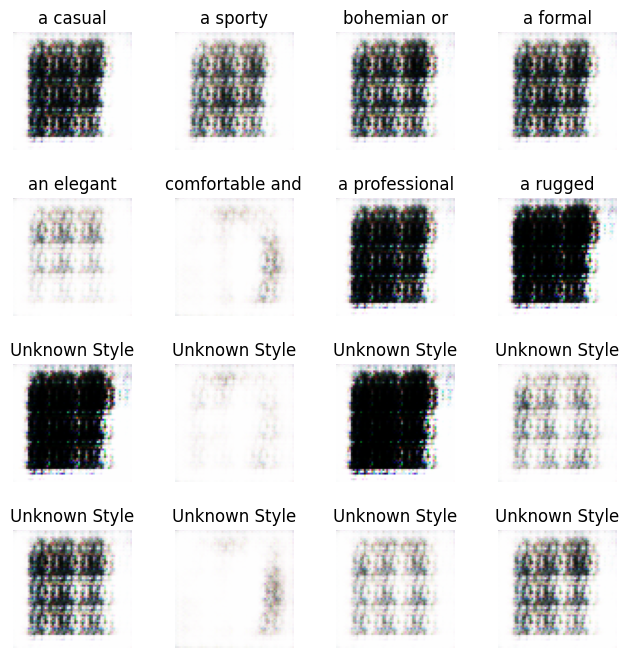

Time for epoch 32 is 29.24 sec
Epoch 33 completed.


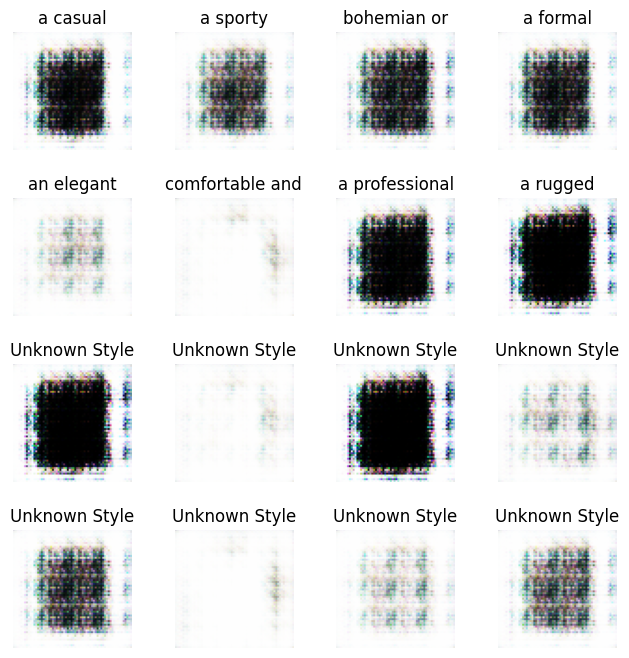

Time for epoch 33 is 30.11 sec
Epoch 34 completed.


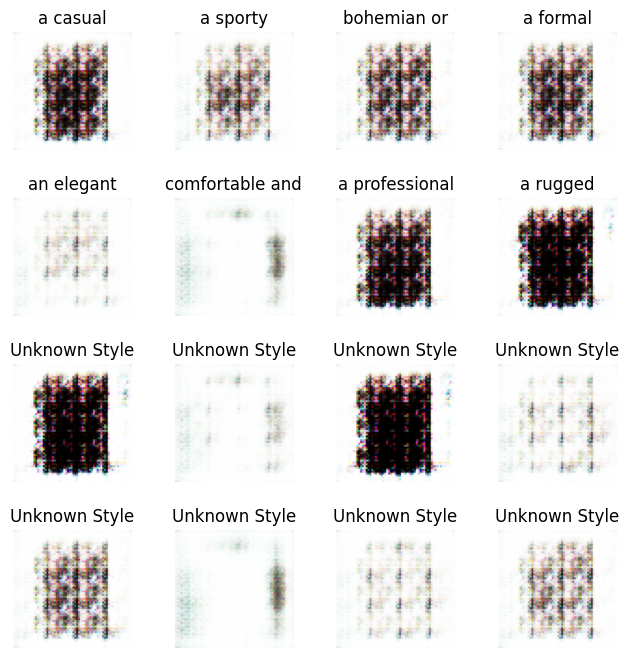

Time for epoch 34 is 29.15 sec
Epoch 35 completed.


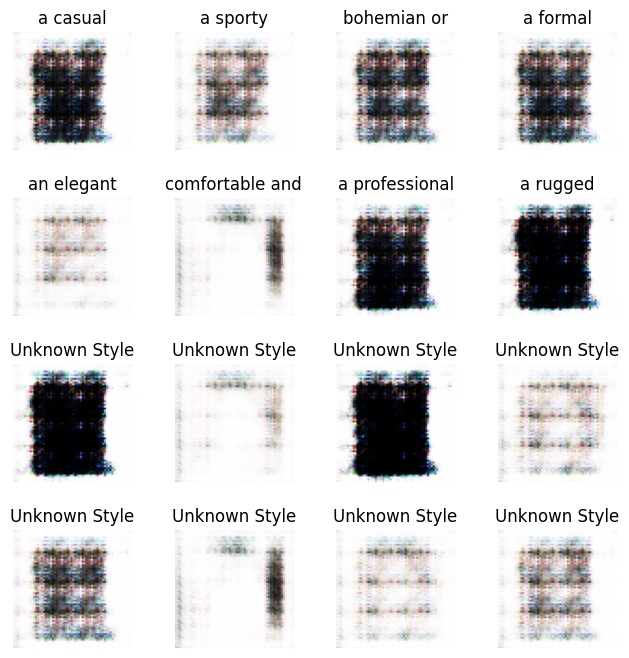

Time for epoch 35 is 30.45 sec
Epoch 36 completed.


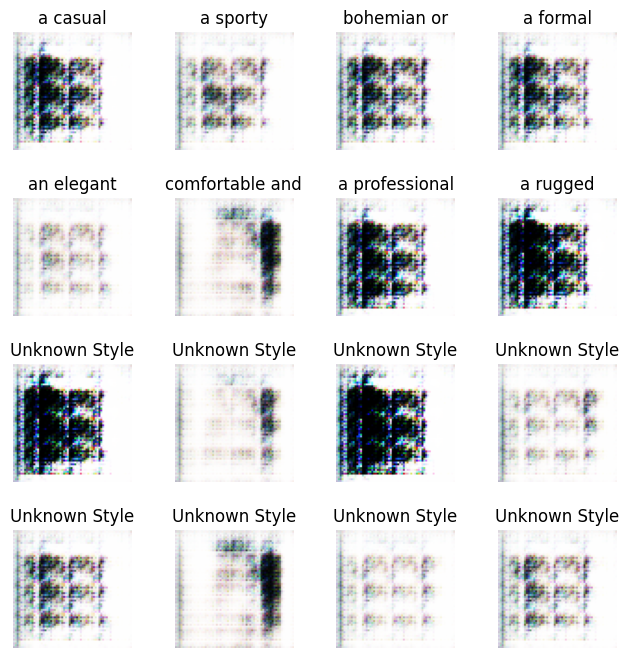

Time for epoch 36 is 28.83 sec
Epoch 37 completed.


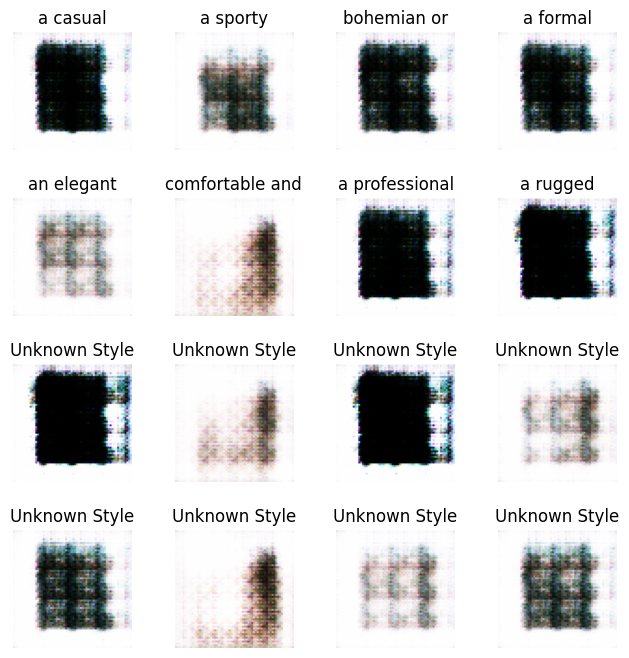

Time for epoch 37 is 29.08 sec
Epoch 38 completed.


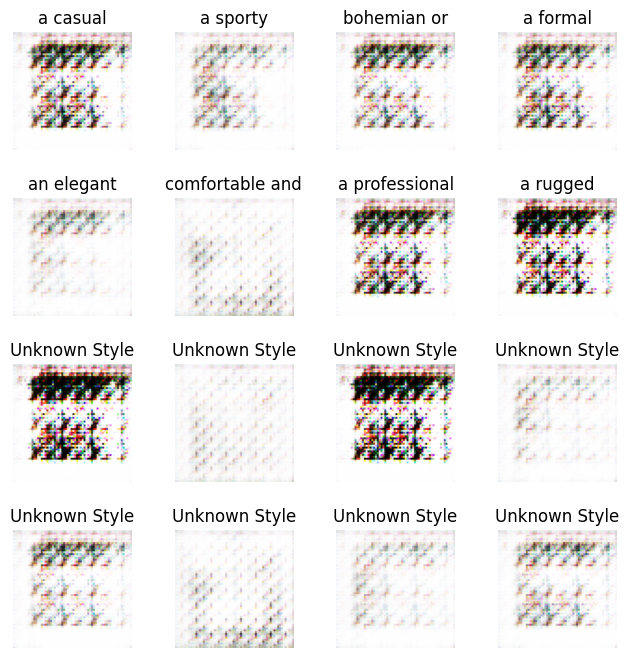

Time for epoch 38 is 28.82 sec
Epoch 39 completed.


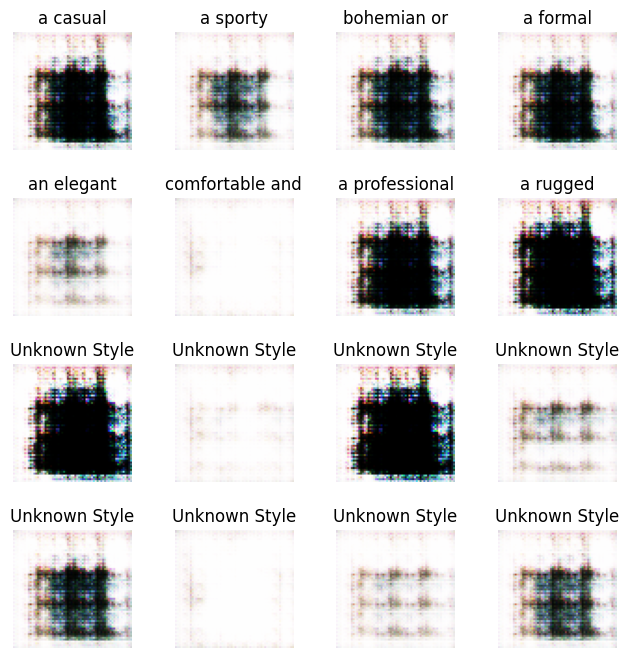

Time for epoch 39 is 29.01 sec
Epoch 40 completed.


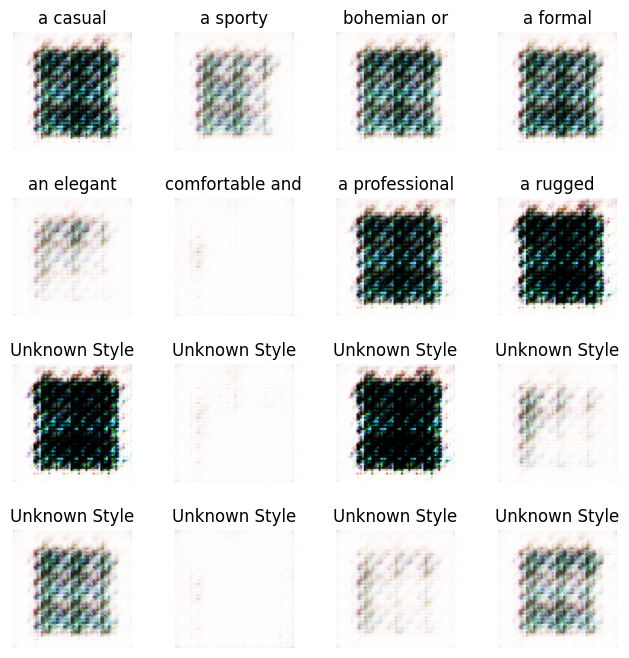

Time for epoch 40 is 28.96 sec
Epoch 41 completed.


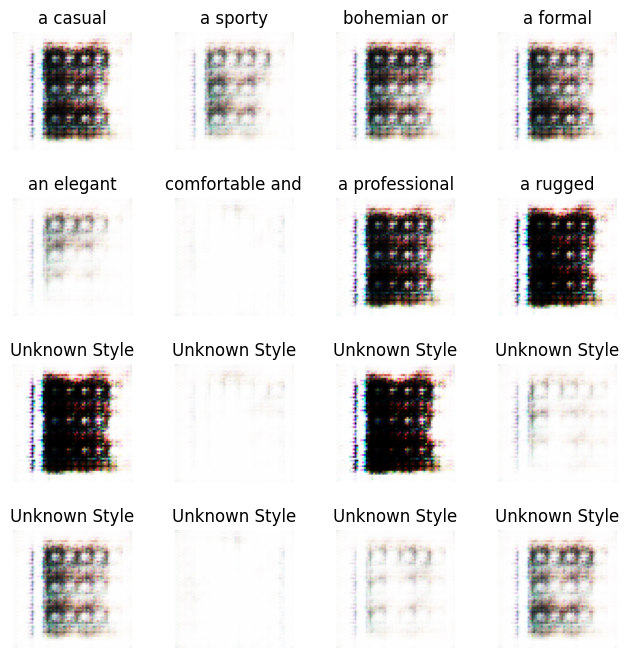

Time for epoch 41 is 29.07 sec
Epoch 42 completed.


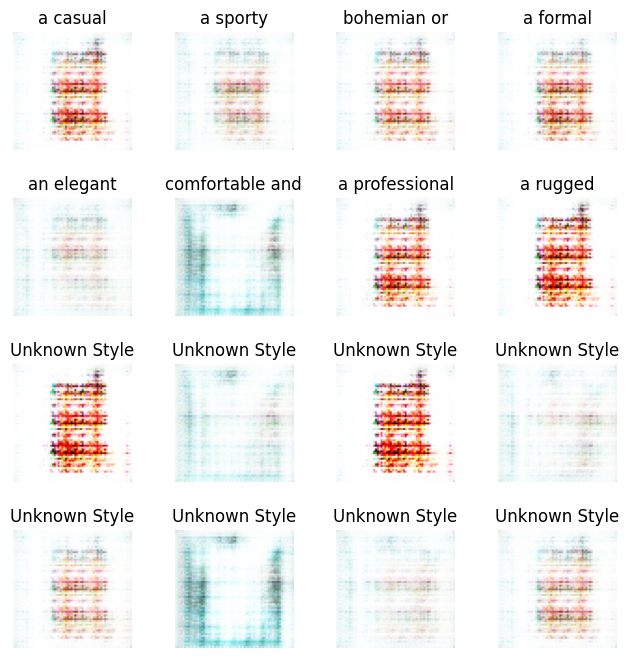

Time for epoch 42 is 29.25 sec
Epoch 43 completed.


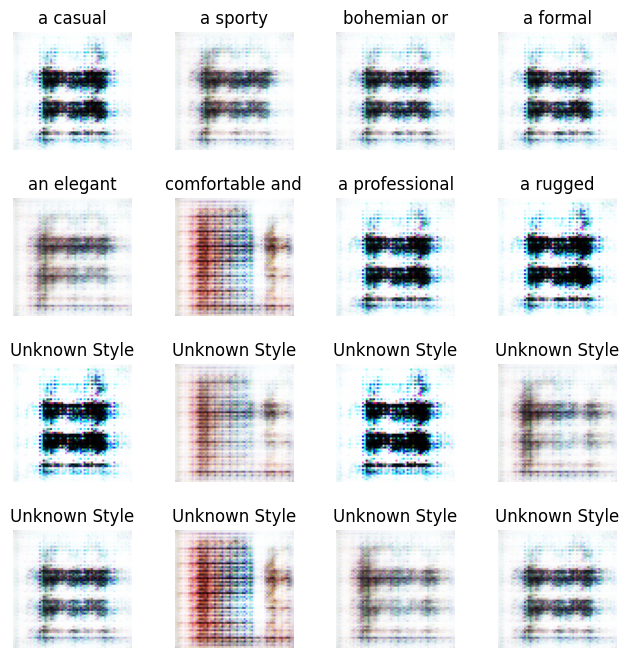

Time for epoch 43 is 29.26 sec
Epoch 44 completed.


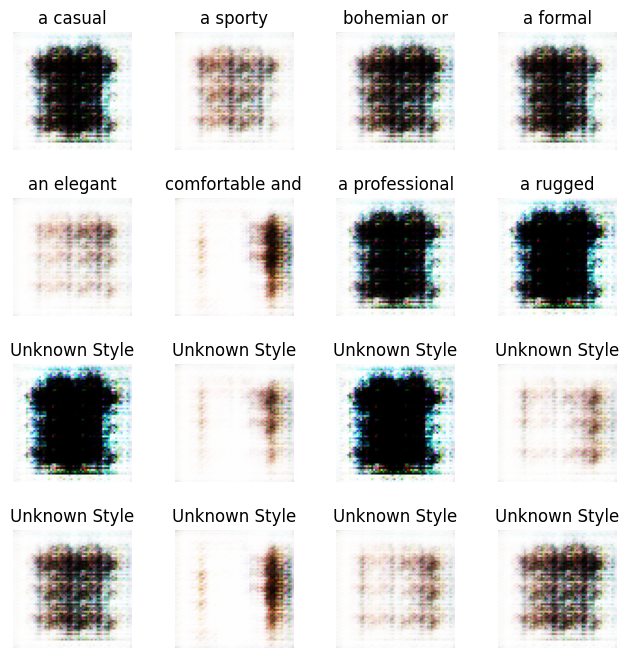

Time for epoch 44 is 29.42 sec
Epoch 49 completed.


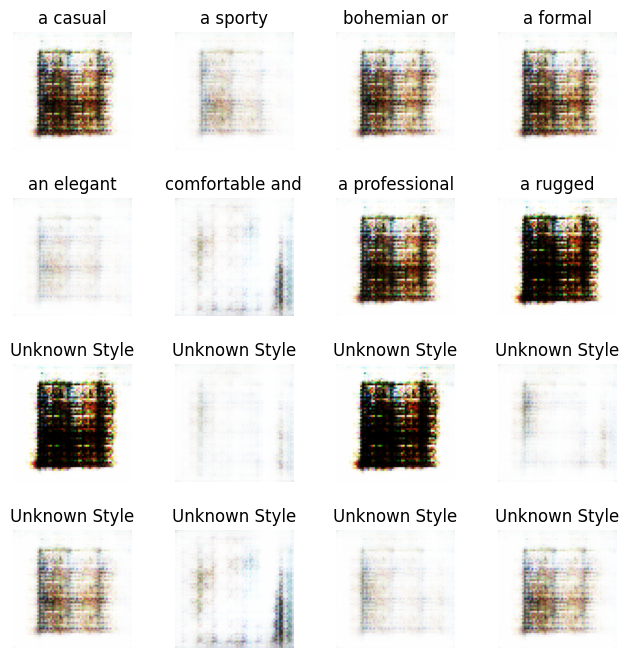

Time for epoch 49 is 28.93 sec
Epoch 50 completed.


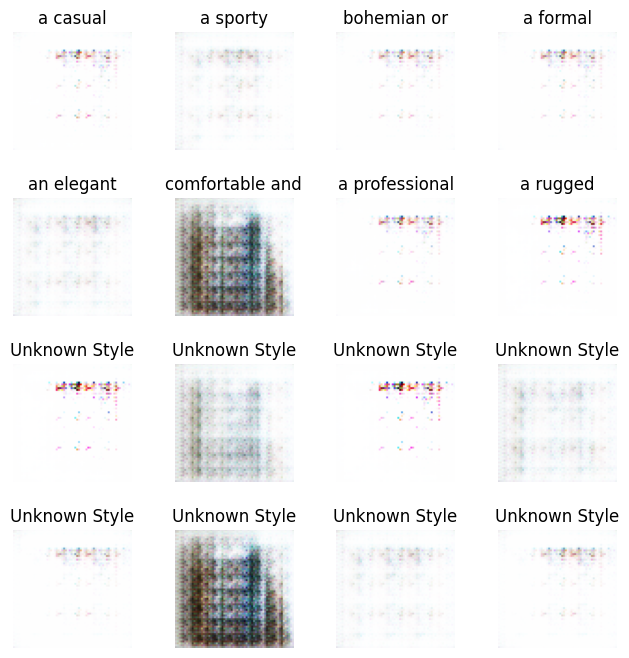

Time for epoch 50 is 28.69 sec
Epoch 51 completed.


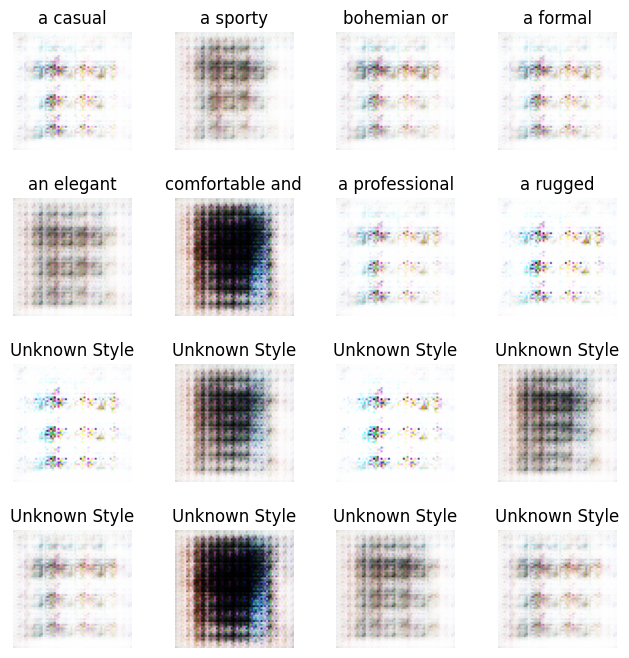

Time for epoch 51 is 28.67 sec
Epoch 52 completed.


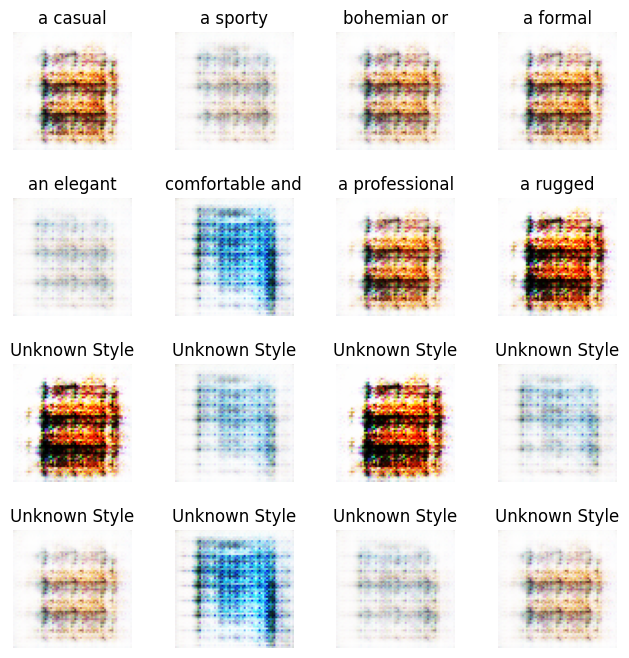

Time for epoch 52 is 29.02 sec
Epoch 53 completed.


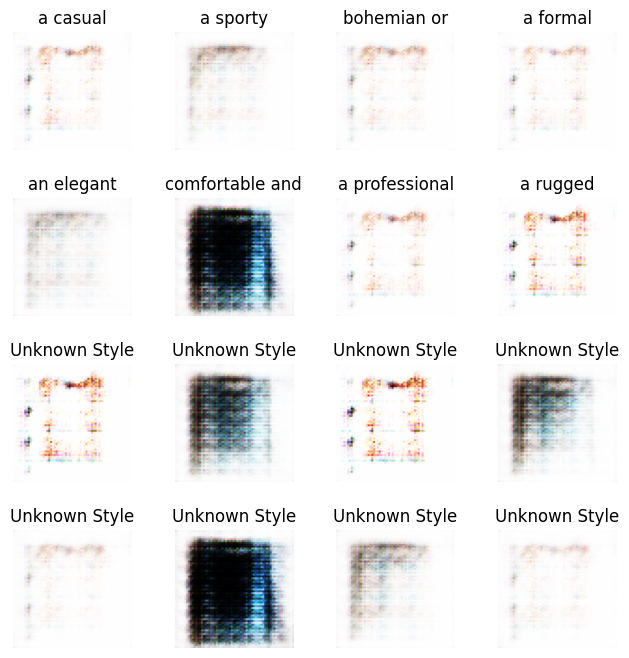

Time for epoch 53 is 28.86 sec
Epoch 54 completed.


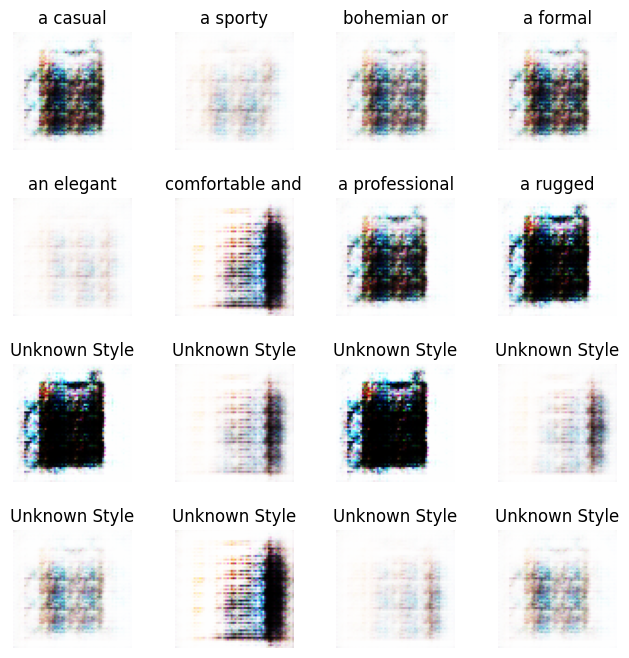

Time for epoch 54 is 29.39 sec
Epoch 55 completed.


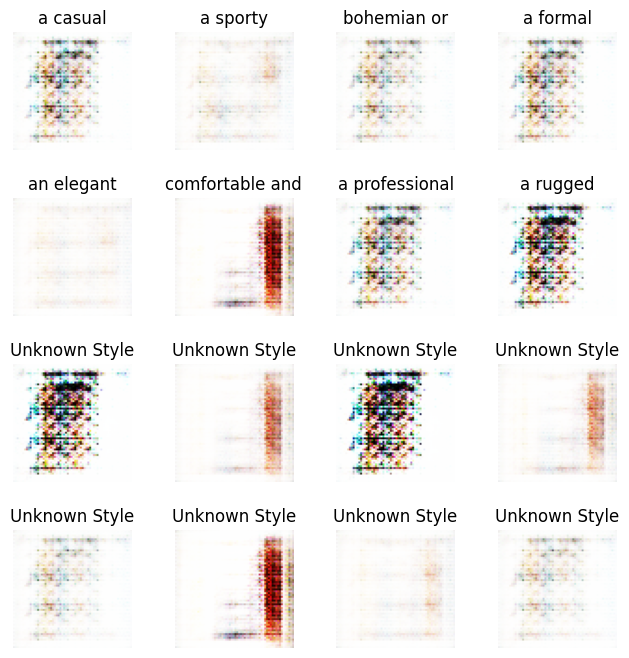

Time for epoch 55 is 29.63 sec
Epoch 56 completed.


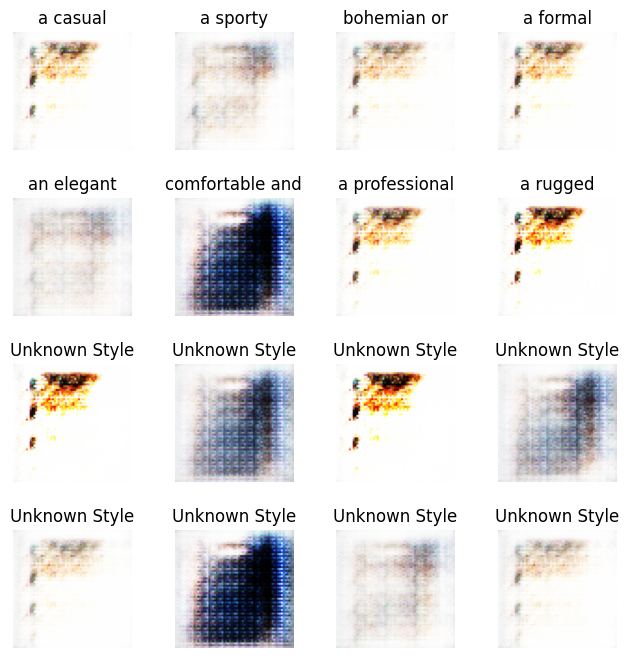

Time for epoch 56 is 29.25 sec
Epoch 57 completed.


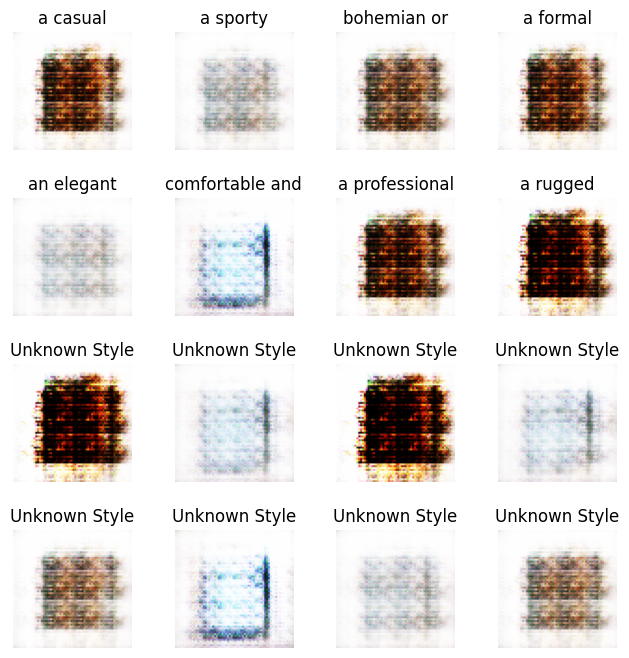

Time for epoch 57 is 29.11 sec
Epoch 58 completed.


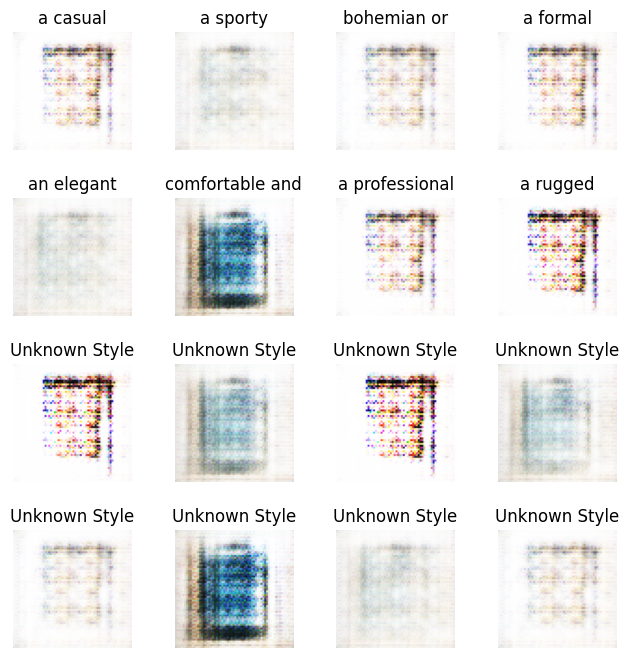

Time for epoch 58 is 29.28 sec
Epoch 59 completed.


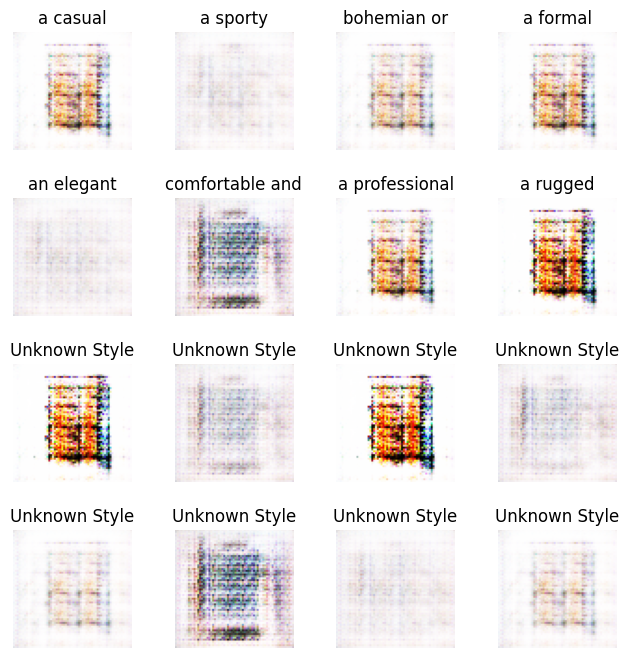

Time for epoch 59 is 29.48 sec
Epoch 60 completed.


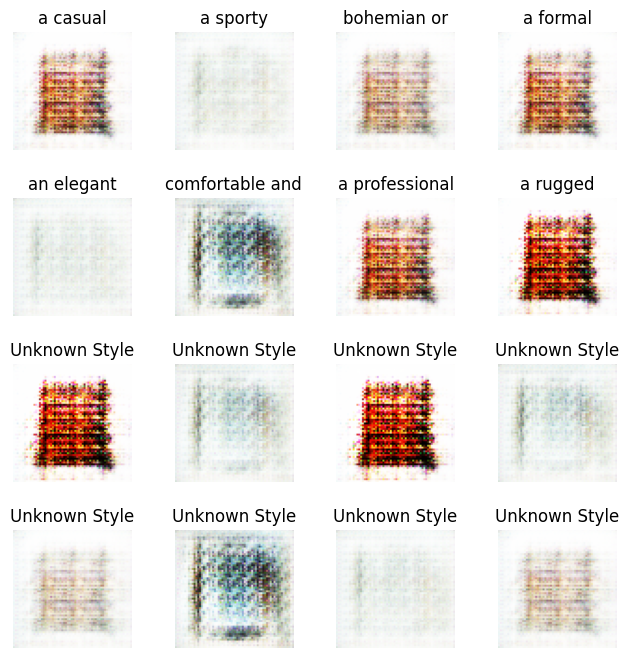

Time for epoch 60 is 29.28 sec
Epoch 61 completed.


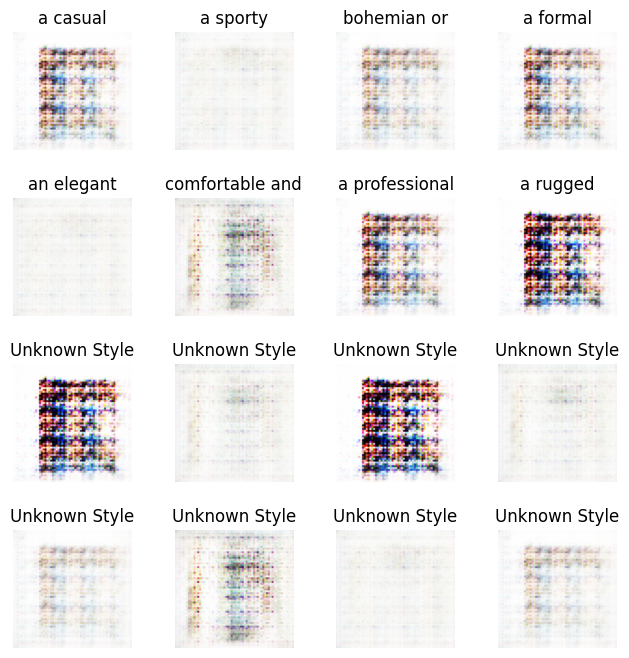

Time for epoch 61 is 29.18 sec
Epoch 62 completed.


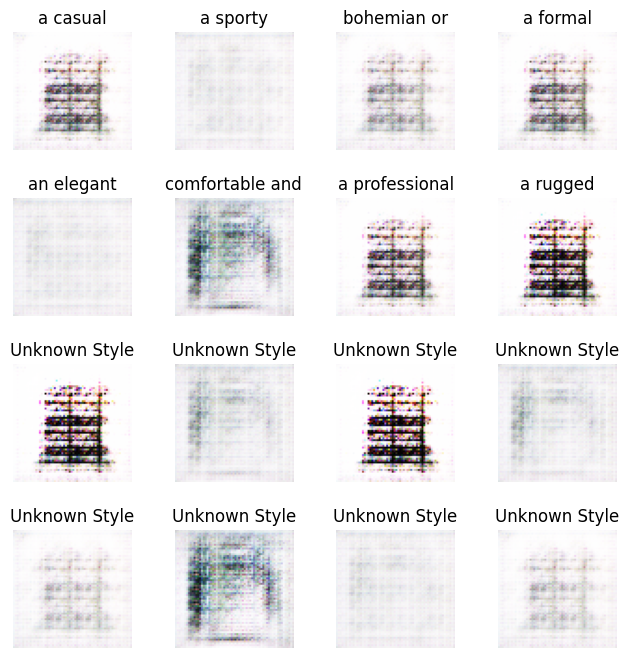

Time for epoch 62 is 28.85 sec
Epoch 63 completed.


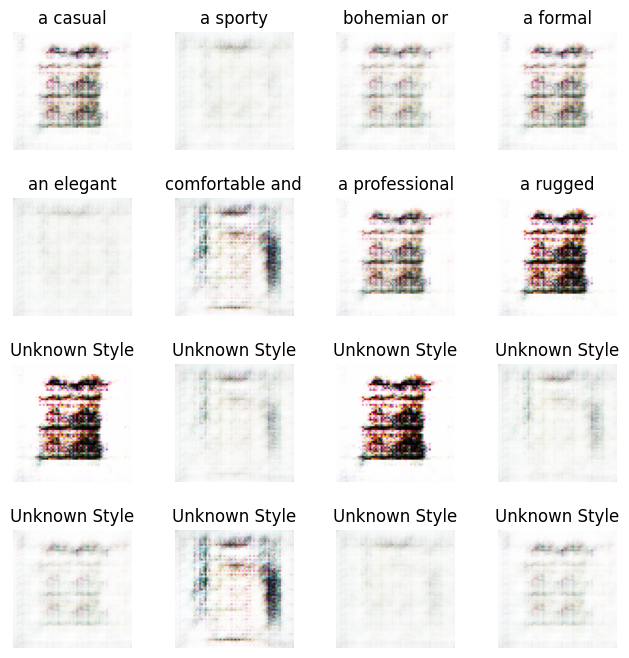

Time for epoch 63 is 28.60 sec
Epoch 64 completed.


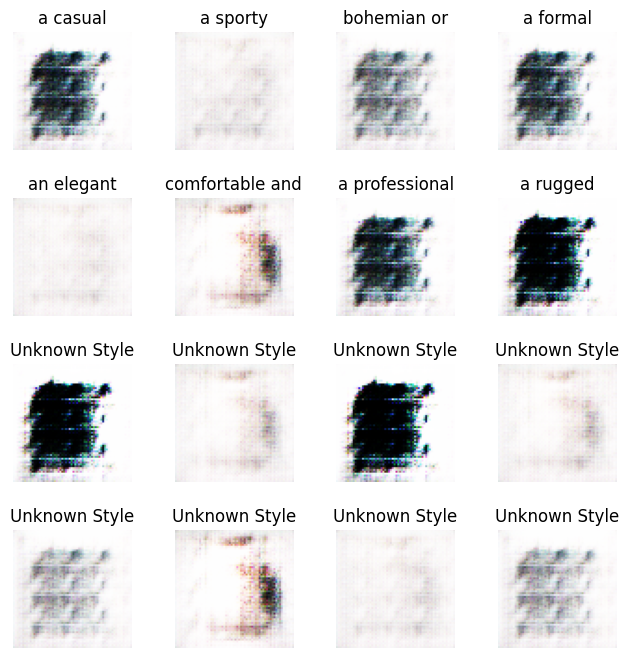

Time for epoch 64 is 28.89 sec
Epoch 65 completed.


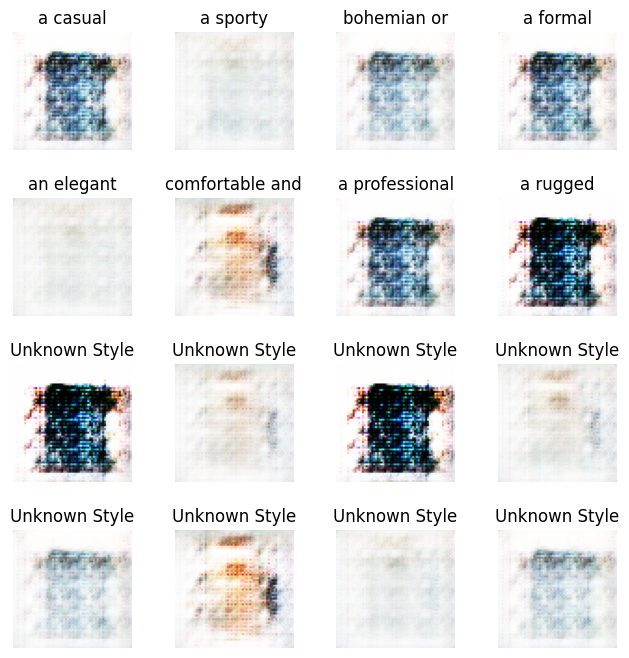

Time for epoch 65 is 29.02 sec
Epoch 66 completed.


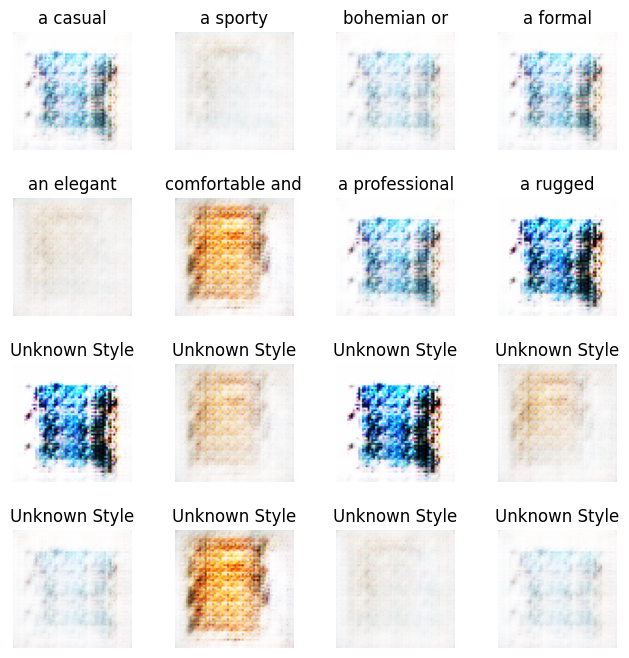

Time for epoch 66 is 29.34 sec
Epoch 67 completed.


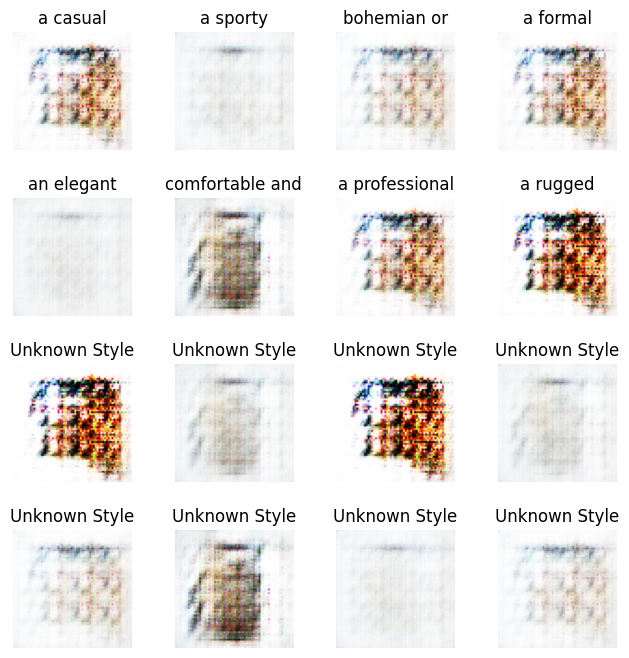

Time for epoch 67 is 29.66 sec
Epoch 68 completed.


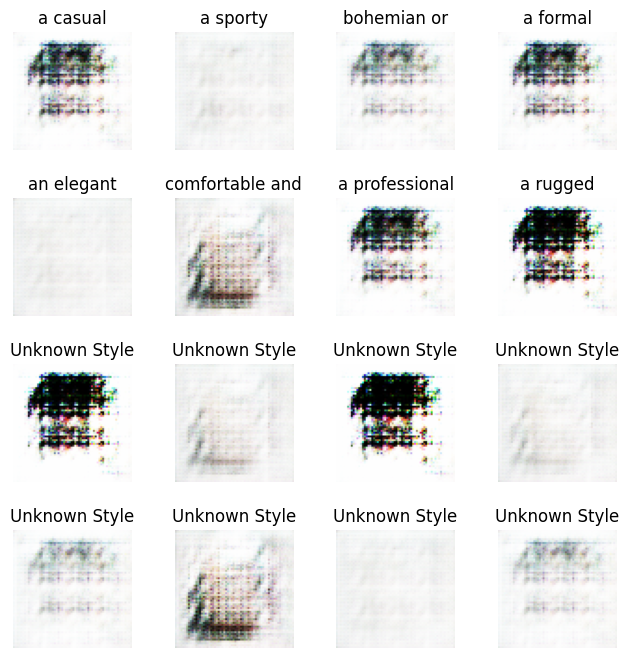

Time for epoch 68 is 29.24 sec
Epoch 69 completed.


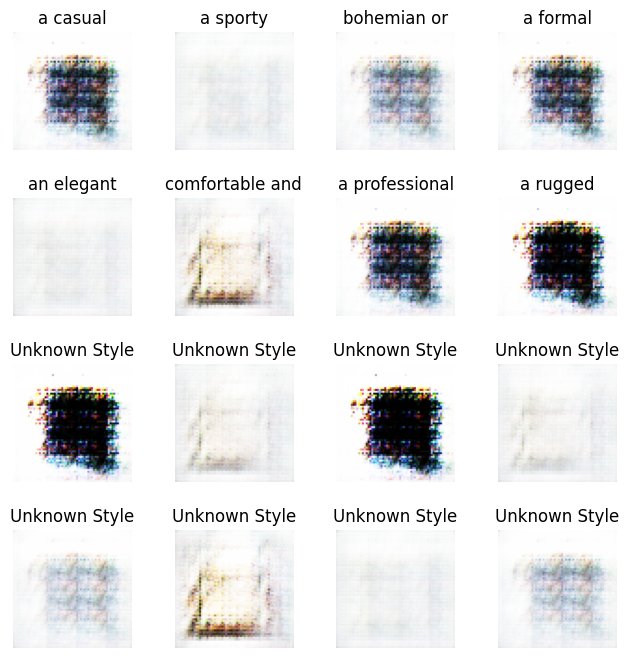

Time for epoch 69 is 29.45 sec
Epoch 70 completed.


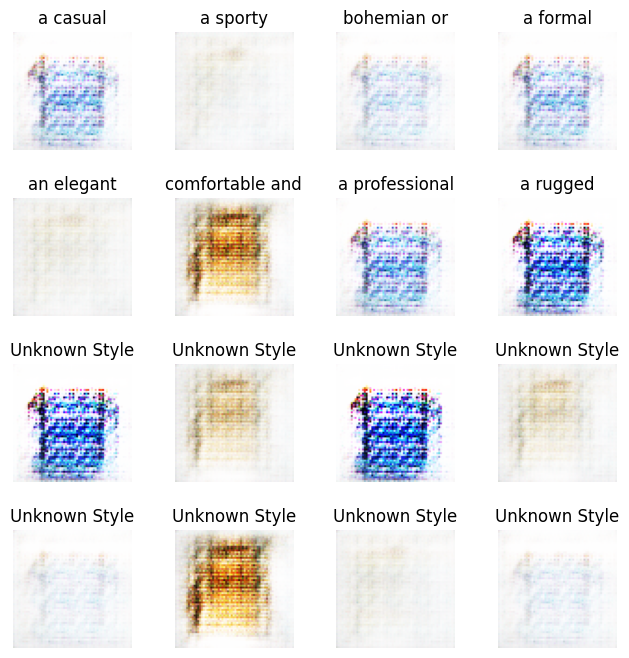

Time for epoch 70 is 28.97 sec
Epoch 71 completed.


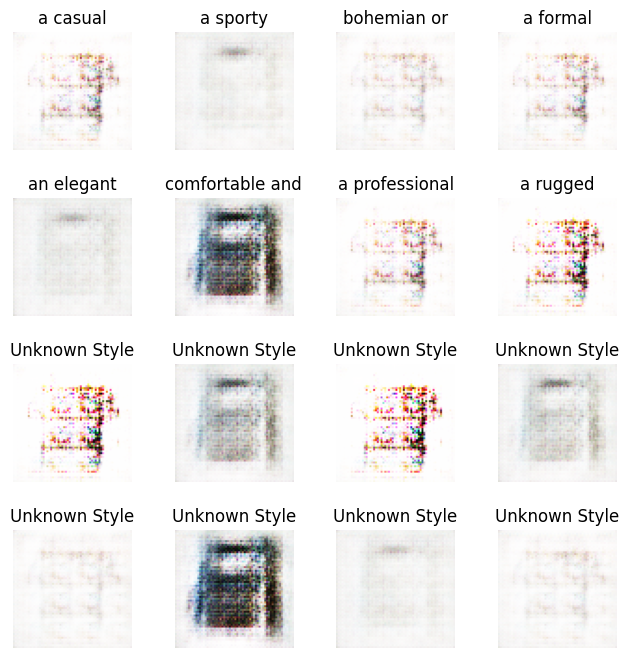

Time for epoch 71 is 28.71 sec
Epoch 72 completed.


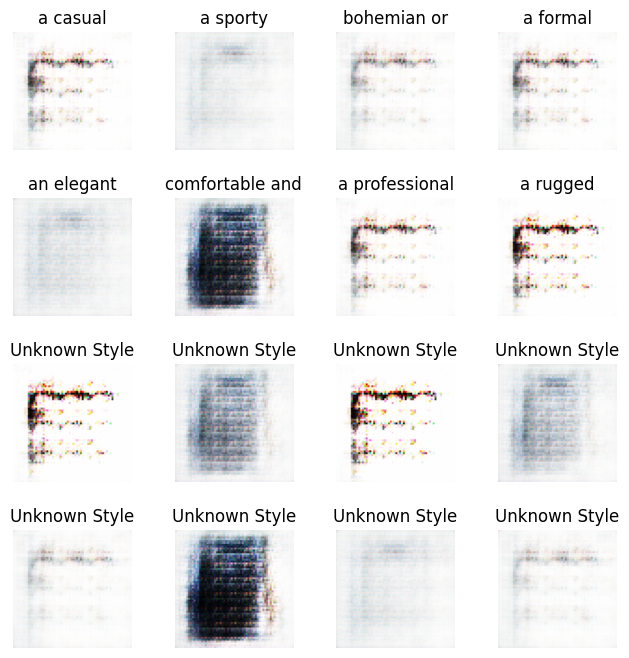

Time for epoch 72 is 28.72 sec
Epoch 73 completed.


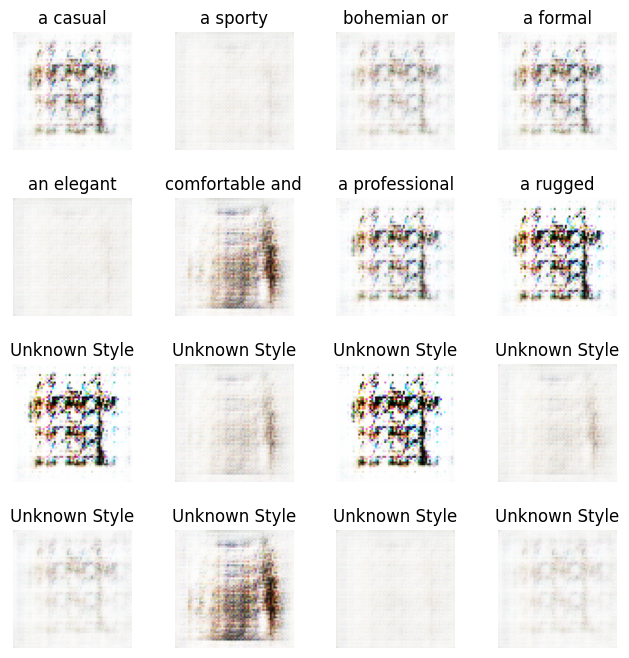

Time for epoch 73 is 29.25 sec
Epoch 74 completed.


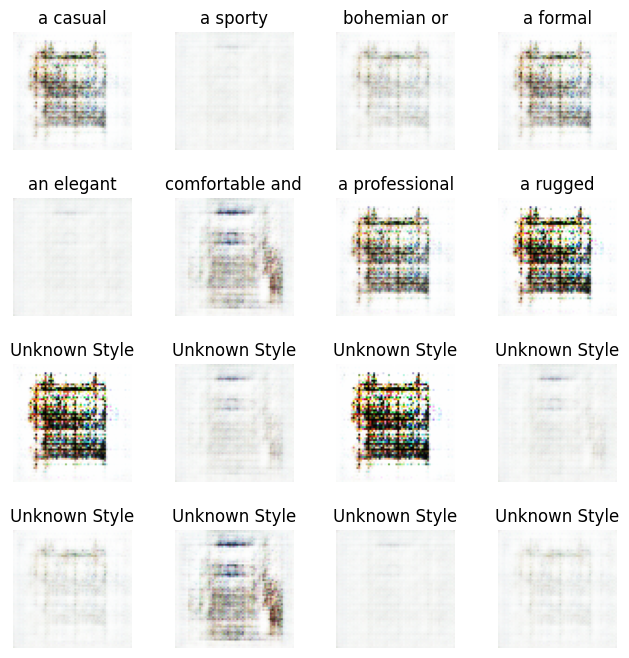

Time for epoch 74 is 29.04 sec
Epoch 75 completed.


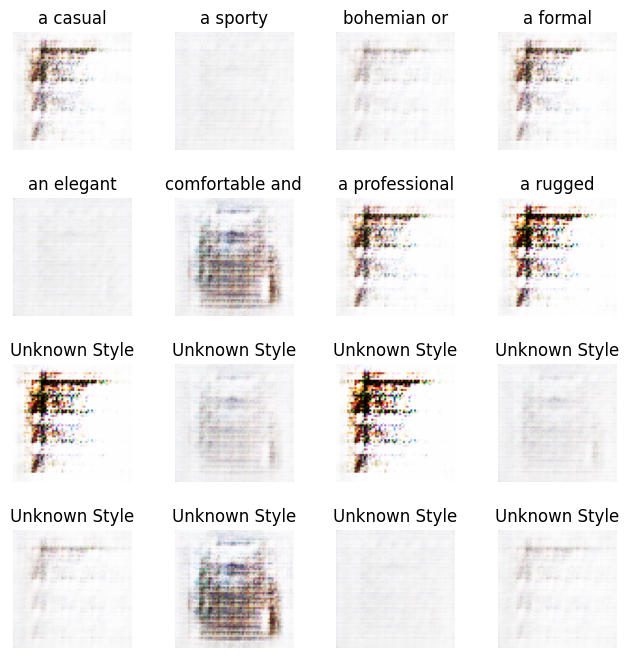

Time for epoch 75 is 28.78 sec
Epoch 76 completed.


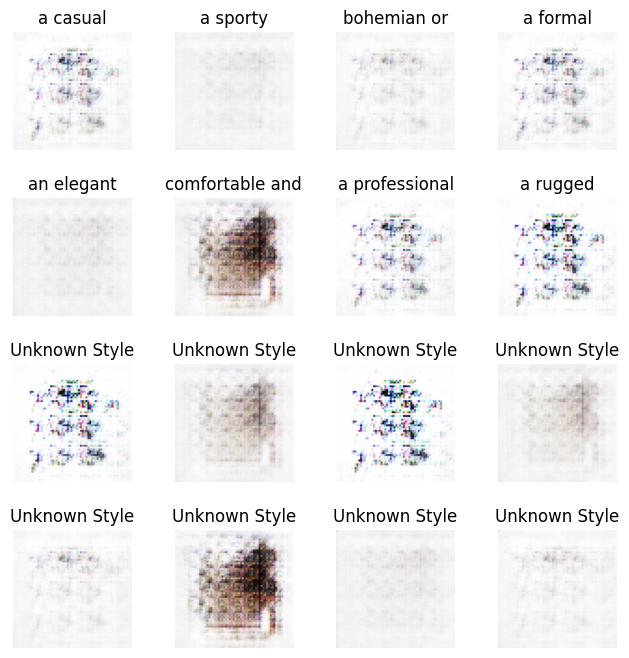

Time for epoch 76 is 29.34 sec
Epoch 77 completed.


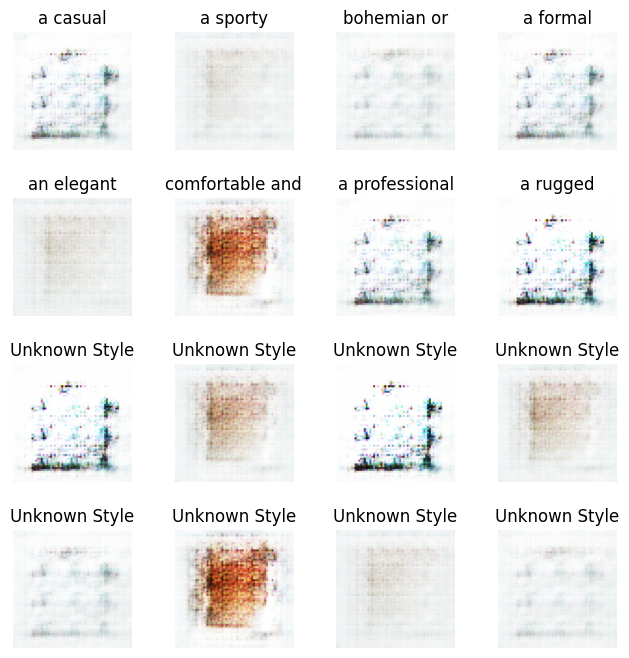

Time for epoch 77 is 29.28 sec
Epoch 78 completed.


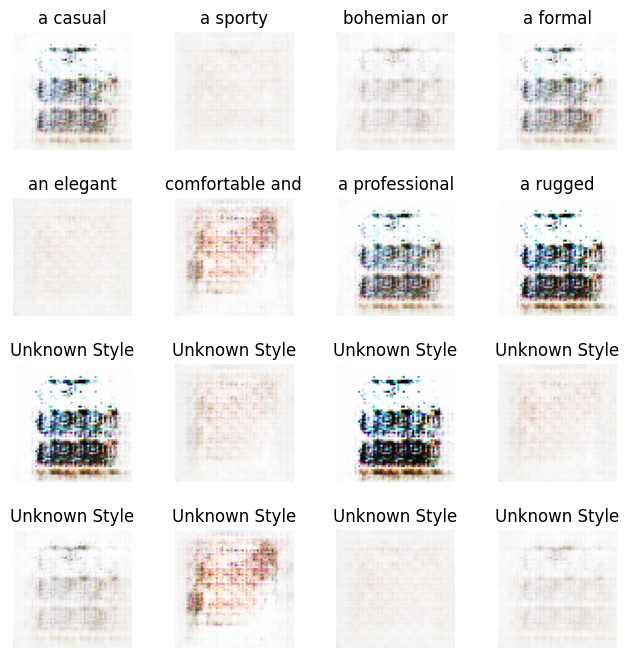

Time for epoch 78 is 29.41 sec
Epoch 79 completed.


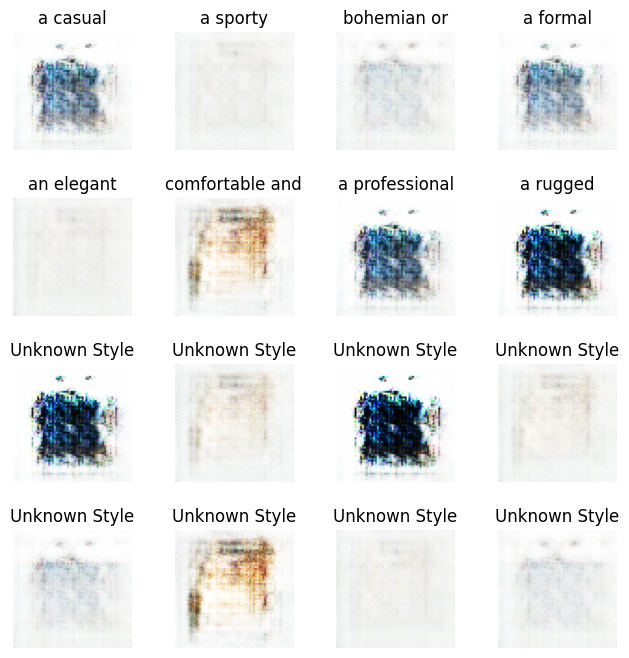

Time for epoch 79 is 29.54 sec
Epoch 80 completed.


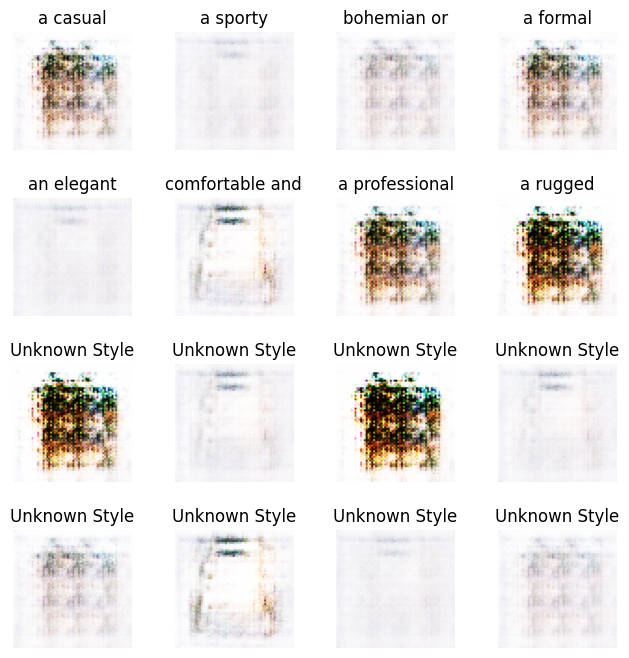

Time for epoch 80 is 29.41 sec
Epoch 81 completed.


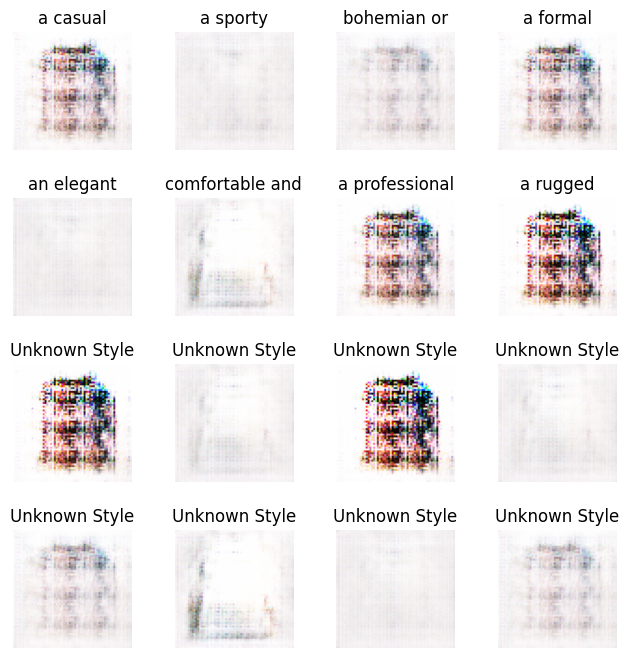

Time for epoch 81 is 28.92 sec
Epoch 82 completed.


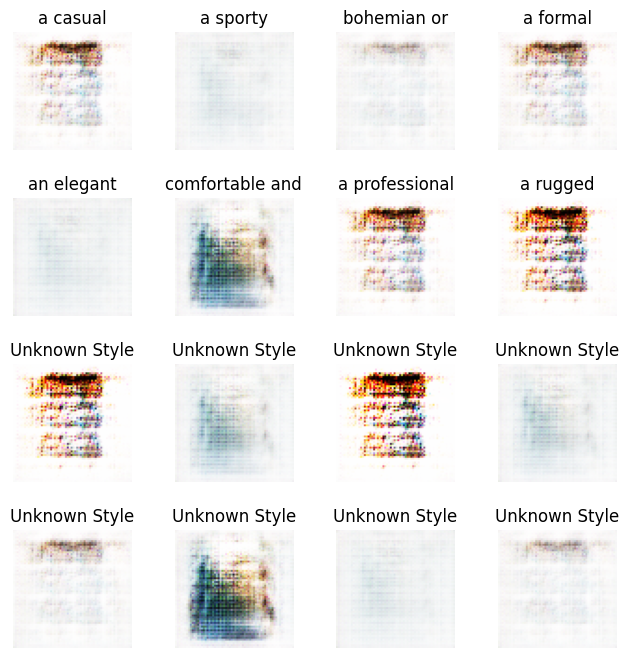

Time for epoch 82 is 28.38 sec
Epoch 83 completed.


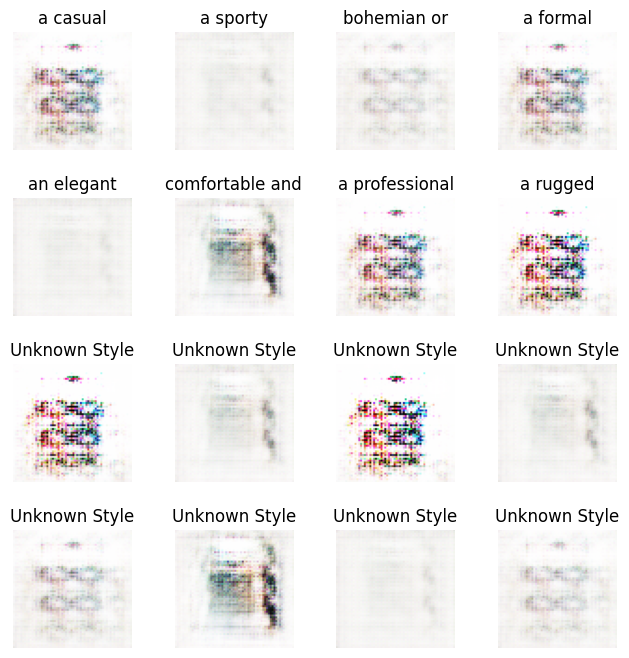

Time for epoch 83 is 28.79 sec


In [ ]:

num_examples_to_generate = 16
seed_noise = tf.random.normal([num_examples_to_generate, NOISE_DIM])
seed_labels_np = np.arange(0, num_examples_to_generate).reshape(-1, 1)

seed_labels = tf.convert_to_tensor(seed_labels_np, dtype=tf.int32)

def generate_and_save_images(model, epoch, test_input_noise, test_input_labels):
    
    predictions = model([test_input_noise, test_input_labels], training=False)

    fig = plt.figure(figsize=(8, 8))
    plt.subplots_adjust(hspace=0.4) # Add some space between plots for titles

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        plt.imshow((predictions[i, :, :, :] + 1) / 2.0)
        
        
        label_id = test_input_labels[i][0].numpy()
        
        
        full_style_name = label_to_style.get(label_id, "Unknown Style")
        
       
        style_name = " ".join(full_style_name.split()[:2])
        
        plt.title(style_name)
        plt.axis('off')

    plt.savefig(os.path.join(OUTPUT_DIR, f'image_at_epoch_{epoch:04d}.png'))
    plt.show()

def train(dataset, epochs):
    print(" Starting Training...")
    for epoch in range(epochs):
        start_time = time.time()

        for image_batch, label_batch in dataset:
            train_step(image_batch, label_batch)

        print(f'Epoch {epoch + 1} completed.')
        generate_and_save_images(generator, epoch + 1, seed_noise, seed_labels)
        
        print(f'Time for epoch {epoch + 1} is {time.time() - start_time:.2f} sec')

    print(" Training Finished!")

# --- Start the Training Process ---
train(dataset, EPOCHS)

In [ ]:
# Cell 6: Generate and Display Final Results for Specific Styles

def generate_style(style_name, num_items=5):
    if style_name not in style_to_label:
        print(f"Style '{style_name}' not found. Please choose from the list.")
        return
        
    label_id = style_to_label[style_name]
    print(f"Generating {num_items} items for style: '{style_name}' (Label: {label_id})")
    
    # Prepare inputs for the generator
    noise = tf.random.normal([num_items, NOISE_DIM])
    labels = np.array([label_id] * num_items).reshape(-1, 1)
    
    # Generate images
    predictions = generator([noise, labels], training=False)
    
    # Display images
    fig = plt.figure(figsize=(15, 3))
    for i in range(predictions.shape[0]):
        plt.subplot(1, num_items, i+1)
        plt.imshow((predictions[i, :, :, :] + 1) / 2) # De-normalize
        plt.axis('off')
    fig.suptitle(f"Generated Style: {style_name}", fontsize=16)
    plt.show()

# --- Generate outfits for a few example styles ---
print("\n--- Generating Final Styled Outfits ---")
generate_style('a casual t-shirt or everyday top')
generate_style('a formal business blouse or professional shirt')
generate_style('an elegant evening gown or glamorous party dress')